# Introduction

How much does what is included in the annotation set matter?

In [1]:
import seaborn
import scipy
import anndata
import pandas
import scanpy
import numpy
from pathlib import Path
from matplotlib import pyplot, cm
import sys
import pysam
from collections import Counter
from IPython import display

import upsetplot

In [2]:
pandas.options.display.max_rows = 300

In [3]:
pwd

'/woldlab/loxcyc/home/diane/proj/encode-202006-jamboree-detrout-rna-sc-pipeline/adrenal/ENCSR724KET_16f_nuc'

In [4]:
project_root = Path("~diane/proj/encode-202006-jamboree-detrout-rna-sc-pipeline").expanduser().absolute()
if str(project_root) not in sys.path:
    sys.path.append(str(project_root))
from common import compute_spearman_anndata

In [5]:
v29_genome_dir = Path("~/proj/genome/").expanduser()
v29_store = pandas.HDFStore(v29_genome_dir / "GRCh38-V29-male" / "GRCh38-V29-male.h5")
v29_gtf = v29_store.select('/gtf', where='type == gene', columns=['gene_id', 'gene_name', 'gene_type'])
v29_store.close()

v29_gene_base_to_id = {}
v29_gene_id_to_name = {}
v29_gene_id_to_type = {}
for i, row in v29_gtf.iterrows():
    v29_gene_base_to_id[row.gene_id.split('.')[0]] = row.gene_id
    v29_gene_id_to_name[row.gene_id] = row.gene_name
    v29_gene_id_to_type[row.gene_id] = row.gene_type

def calculate_v29_gene_base(gene_id):
    gene_base = gene_id.split('.')[0]
    if gene_id.endswith("_PAR_Y"):
        gene_base += "_PAR_Y"
    return gene_base
v29_gtf['gene_base'] = v29_gtf['gene_id'].apply(calculate_v29_gene_base)

In [6]:
v32m_genome_dir = Path("~/proj/encode-202006-jamboree-detrout-rna-sc-pipeline/genome/").expanduser()
v32m_store = pandas.HDFStore(v32m_genome_dir / "GRCh38-arc2.0-2.7.8a" / "GRCh38-arc2.0-2.7.8a.h5")
v32m_gtf = v32m_store.select('/gtf', where='type == gene', columns=['gene_id', 'gene_name', 'gene_type'])
v32m_store.close()

v32m_gtf.columns = ['gene_base', 'gene_name', 'gene_type']
v32m_gtf['gene_id'] = v32m_gtf['gene_base'].apply(lambda x: v29_gene_base_to_id.get(x, x))

v32m_gene_id_to_name = {}
v32m_gene_id_to_type = {}
for i, row in v32m_gtf.iterrows():
    v32m_gene_id_to_name[row.gene_id] = row.gene_name
    v32m_gene_id_to_type[row.gene_id] = row.gene_type

In [7]:
def scanpy_load_solo278a_mtx(analysis_dir, quantification="Gene", mode="filtered", multiread="Unique"):
    assert mode in ["filtered", "raw"], "STAR Solo only produces raw or filtered files"
    assert quantification in ["Gene", "GeneFull", "GeneFull_Ex50pAS", "SJ"]
    MULTIREAD_MATRIX = {
    "Unique": "matrix.mtx",
    "Rescue": "UniqueAndMult-Rescue.mtx",
    "EM": "UniqueAndMult-EM.mtx",
    }
    assert multiread in MULTIREAD_MATRIX

    analysis_dir = Path(analysis_dir)
    
    solo_dir = analysis_dir / "Solo.out" / quantification 
    solo = scanpy.read_mtx(solo_dir / "raw" / MULTIREAD_MATRIX[multiread]).T
    solo_vars = pandas.read_csv(
        solo_dir / "raw" / "features.tsv", header=None, sep="\t"
    ).values.T
    solo_obs = pandas.read_csv(
        solo_dir / "raw" / "barcodes.tsv", header=None, sep="\t"
    ).values.T
    solo.obs_names = solo_obs[0]
    solo.var_names = solo_vars[0]
    
    if mode == "filtered":
        solo_obs = pandas.read_csv(
            solo_dir / mode / "barcodes.tsv", header=None, sep="\t"
        ).values.T[0]
        solo = solo[solo_obs,:]
        

    solo.obs["counts"] = solo.X.sum(axis=1)
    solo.obs["ngenes"] = numpy.array((solo.X > 0).sum(axis=1))

    return solo



I tried to do an analysis using the the different modes of soloMultiMappers but they seemed too similar.
Then I computed the md5sum of the matrix files... and yeah the argument didn't seem to do anything.

<table>
<tr><td>ffb6d23ee397674a310d93039e4111a7</td><td>fullsolo_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
<tr><td>ffb6d23ee397674a310d93039e4111a7</td><td>fullsolo_em_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
<tr><td>ffb6d23ee397674a310d93039e4111a7</td><td>fullsolo_rescue_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
<tr><td>00dd2450e656ceaffe533c4558e16227</td><td>minimalsolo_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
<tr><td>00dd2450e656ceaffe533c4558e16227</td><td>minimalsolo_em_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
<tr><td>00dd2450e656ceaffe533c4558e16227</td><td>minimalsolo_rescue_2.7.9a_2021-06-25/Solo.out/GeneFull/filtered/matrix.mtx</td></tr>
</table>

I also learned that there's some gene base ids that have two version varients. (One example)
<table>
<tr><td>gene_id 	</td><td>gene_name 	</td><td>gene_type</td></tr>
<tr><td>ENSG00000169084.13 	</td><td>DHRSX 	</td><td>protein_coding</td></tr>
    <tr><td>ENSG00000169084.13_PAR_Y 	</td><td>DHRSX 	</td><td>protein_coding</td></tr>
</table>

# Load Datasets

In [8]:
algorithm_roots = {
    "full 100% uniq": (Path("fullsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Unique"),
    "full 50% uniq": (Path("fullsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Unique"),
    "minimal 100% uniq": (Path("minimalsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Unique"),
    "minimal 50% uniq": (Path("minimalsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Unique"),
    "tenx 100% uniq": (Path("tenxsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Unique"),
    "tenx 50% uniq": (Path("tenxsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Unique"),

    "full 100% rescue": (Path("fullsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Rescue"),
    "full 50% rescue": (Path("fullsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Rescue"),
    "minimal 100% rescue": (Path("minimalsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Rescue"),
    "minimal 50% rescue": (Path("minimalsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Rescue"),
    "tenx 100% rescue": (Path("tenxsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "Rescue"),
    "tenx 50% recscue": (Path("tenxsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "Rescue"),
    
    "full 100% em": (Path("fullsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "EM"),
    "full 50% em": (Path("fullsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "EM"),
    "minimal 100% em": (Path("minimalsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "EM"),
    "minimal 50% em": (Path("minimalsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "EM"),
    "tenx 100% em": (Path("tenxsolo_multi_2.7.9a_2021-06-25"), "GeneFull", "filtered", "EM"),
    "tenx 50% em": (Path("tenxsolo_multi_dev_EoI_2.7.9a_2021-09-10"), "GeneFull_Ex50pAS", "filtered", "EM"),
}

algorithm_suffix = {
    "full 100% uniq": "f1u",
    "full 50% uniq": "f½u",
    "minimal 100% uniq": "m1u",
    "minimal 50% uniq": "m½u",
    "tenx 100% uniq": "t1u",
    "tenx 50% uniq": "t½u",

    "full 100% rescue": "f1r",
    "full 50% rescue": "f½r",
    "minimal 100% rescue": "m1r",
    "minimal 50% rescue": "m½r",
    "tenx 100% rescue": "t1r",
    "tenx 50% recscue": "t½r",
    
    "full 100% em": "f1e",
    "full 50% em": "f½e",
    "minimal 100% em": "m1e",
    "minimal 50% em": "m½e",
    "tenx 100% em": "t1e",
    "tenx 50% em": "t½e",
}
#Path("ENCSR362YDM_26m_nuc/fullsolo_multi_2.7.9a_2021-06-25/GeneFull_EM.tar.gz
#Path("ENCSR724KET_16f_nuc/fullsolo_multi_2.7.9a_2021-06-25/GeneFull_EM.tar.gz
#Path("ENCSR726IPC_59f_nuc/fullsolo_multi_2.7.9a_2021-06-25/GeneFull_EM.tar.gz
    

In [9]:
algorithm_filtered = {}
for algorithm in algorithm_roots:
    root, quantification, filtering, multiread = algorithm_roots[algorithm]
    print("loading {}".format(algorithm))
    algorithm_filtered[algorithm] = scanpy_load_solo278a_mtx(root, quantification, filtering, multiread)
    print(algorithm, algorithm_filtered[algorithm].shape, algorithm_filtered[algorithm].X.sum())

loading full 100% uniq


Trying to set attribute `.obs` of view, copying.


full 100% uniq (15605, 59526) 80314560.0
loading full 50% uniq


Trying to set attribute `.obs` of view, copying.


full 50% uniq (15708, 59526) 81643896.0
loading minimal 100% uniq


Trying to set attribute `.obs` of view, copying.


minimal 100% uniq (15650, 28249) 78668630.0
loading minimal 50% uniq


Trying to set attribute `.obs` of view, copying.


minimal 50% uniq (15782, 28249) 80011320.0
loading tenx 100% uniq


Trying to set attribute `.obs` of view, copying.


tenx 100% uniq (15812, 36601) 84269840.0
loading tenx 50% uniq


Trying to set attribute `.obs` of view, copying.


tenx 50% uniq (15859, 36601) 84515990.0
loading full 100% rescue


Trying to set attribute `.obs` of view, copying.


full 100% rescue (15605, 59526) 89503700.0
loading full 50% rescue


Trying to set attribute `.obs` of view, copying.


full 50% rescue (15708, 59526) 88240450.0
loading minimal 100% rescue


Trying to set attribute `.obs` of view, copying.


minimal 100% rescue (15650, 28249) 85005160.0
loading minimal 50% rescue


Trying to set attribute `.obs` of view, copying.


minimal 50% rescue (15782, 28249) 84330530.0
loading tenx 100% rescue


Trying to set attribute `.obs` of view, copying.


tenx 100% rescue (15812, 36601) 89073760.0
loading tenx 50% recscue


Trying to set attribute `.obs` of view, copying.


tenx 50% recscue (15859, 36601) 87780140.0
loading full 100% em


Trying to set attribute `.obs` of view, copying.


full 100% em (15605, 59526) 89503690.0
loading full 50% em


Trying to set attribute `.obs` of view, copying.


full 50% em (15708, 59526) 88240440.0
loading minimal 100% em


Trying to set attribute `.obs` of view, copying.


minimal 100% em (15650, 28249) 85005160.0
loading minimal 50% em


Trying to set attribute `.obs` of view, copying.


minimal 50% em (15782, 28249) 84330530.0
loading tenx 100% em


Trying to set attribute `.obs` of view, copying.


tenx 100% em (15812, 36601) 89073760.0
loading tenx 50% em


Trying to set attribute `.obs` of view, copying.


tenx 50% em (15859, 36601) 87780140.0


# Add (faked) version to 10x annotation

The 10x provided annotation GTF file, based on GENCODE V32, has the gene version number removed, to make later comparisons easier I added the gene version number from my V29 GTF on to the V32 gene base ids.

(Gene base = ENSG00000243485)

(Gene id with version = ENSG00000243485.5)

In [10]:
for algorithm in algorithm_filtered:
    if algorithm.startswith("tenx"):
        algorithm_filtered[algorithm].var_names = v32m_gtf.set_index('gene_base').reindex(algorithm_filtered[algorithm].var_names.to_list())['gene_id']

# Cell barcodes in common

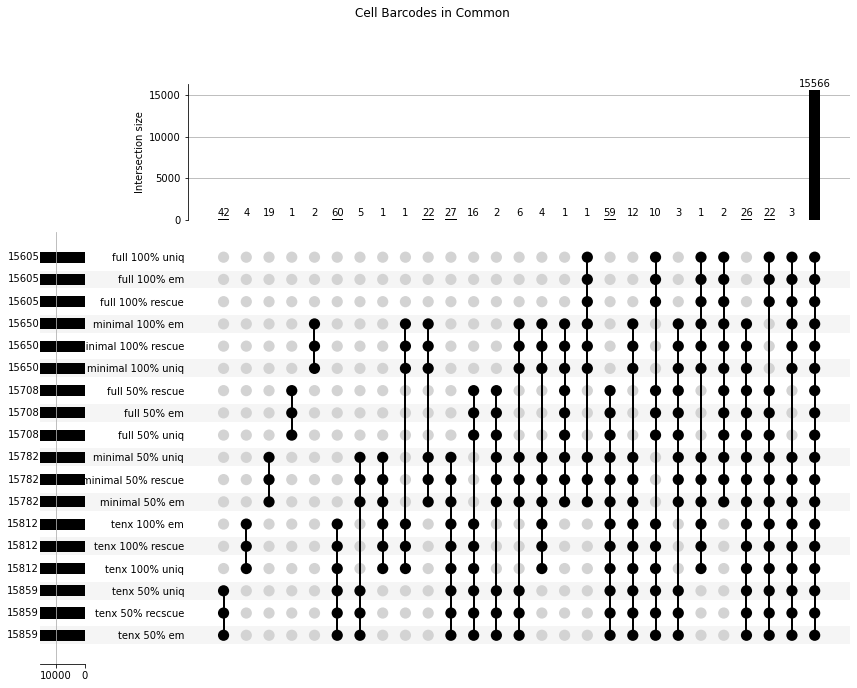

In [15]:
algorithm_cell_barcodes = {}
for algorithm in algorithm_filtered:
    algorithm_cell_barcodes[algorithm] = algorithm_filtered[algorithm].obs_names

common_cell_barcode_set = upsetplot.from_contents(algorithm_cell_barcodes)
f = pyplot.figure()
f.suptitle("Cell Barcodes in Common")
_ = upsetplot.plot(common_cell_barcode_set, fig=f, show_counts=True)


# localize barcode name to dataset

In [16]:
for algorithm in algorithm_filtered:
    adata = algorithm_filtered[algorithm]
    adata.obs_names = ["{}_{}".format(x, algorithm_suffix[algorithm]) for x in algorithm_filtered[algorithm].obs_names]

# Lets try the scanpy tutorial

full 100% uniq first phase QC


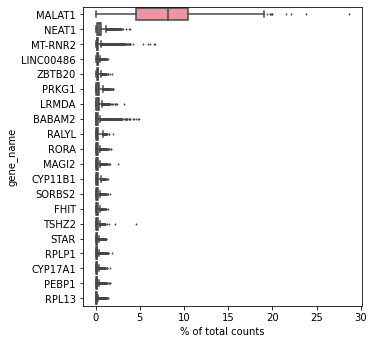

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

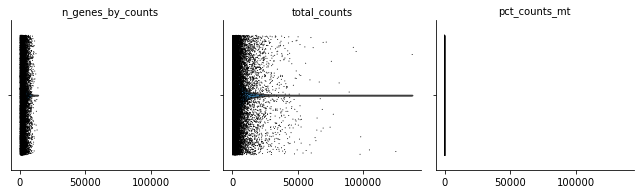

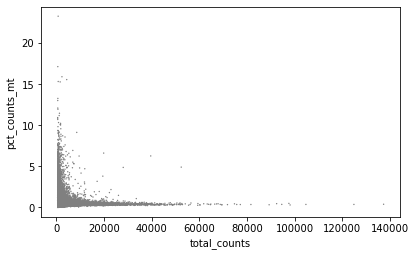

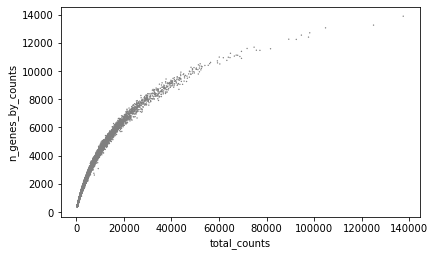

full 50% uniq first phase QC


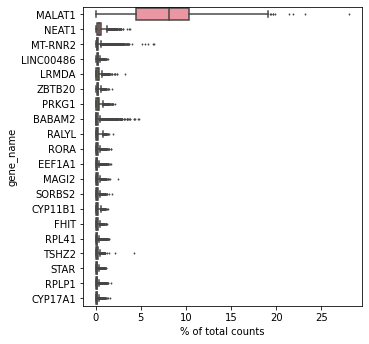

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

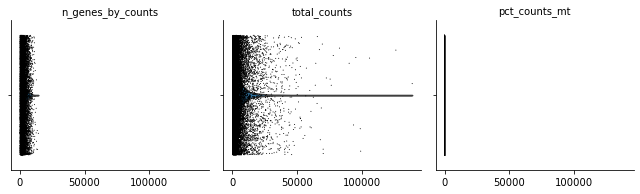

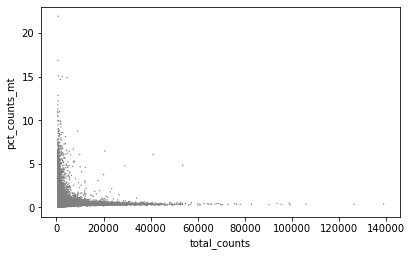

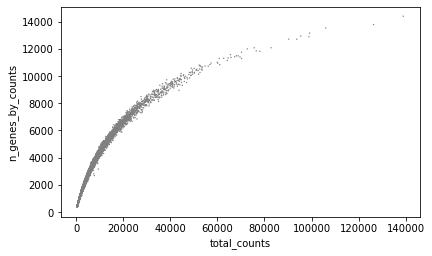

minimal 100% uniq first phase QC


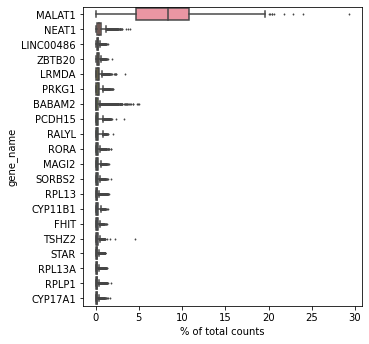

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

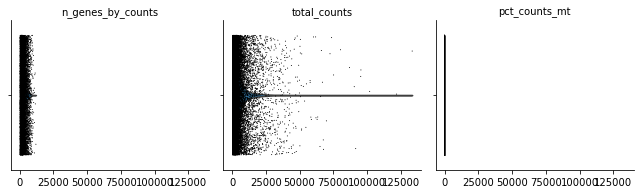

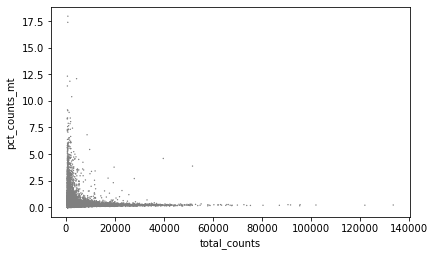

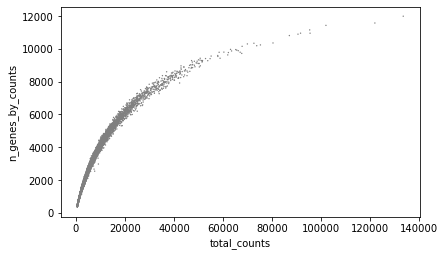

minimal 50% uniq first phase QC


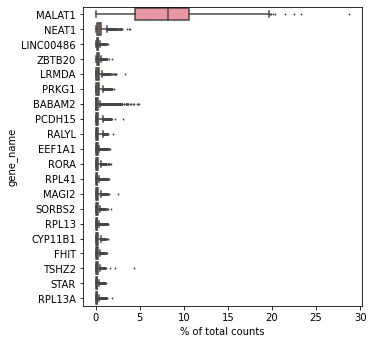

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

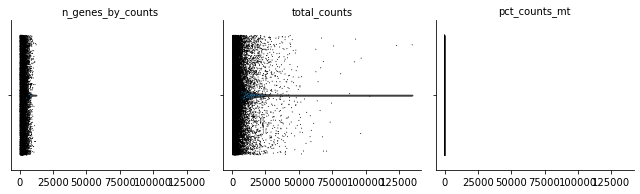

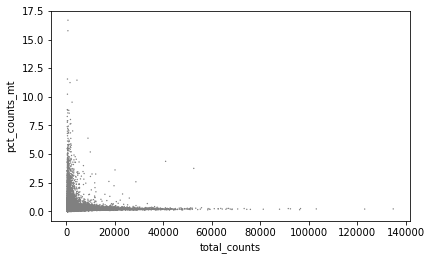

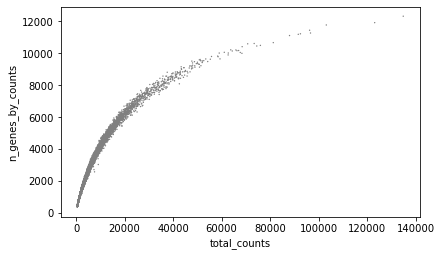

tenx 100% uniq first phase QC


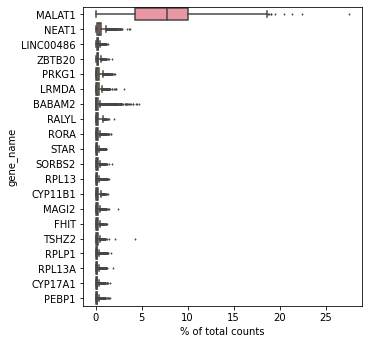

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

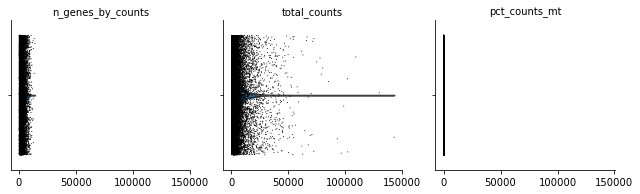

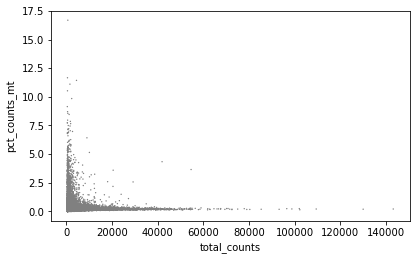

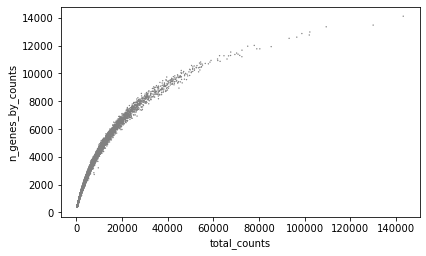

tenx 50% uniq first phase QC


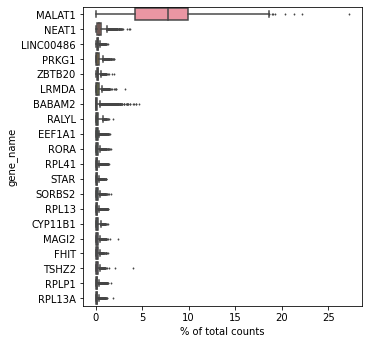

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

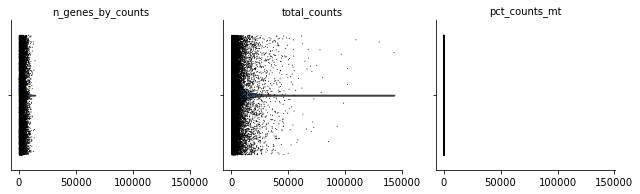

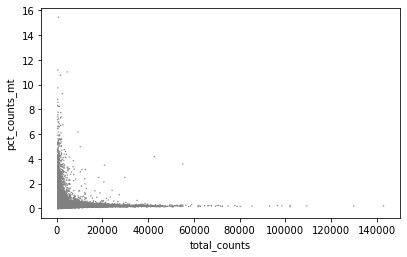

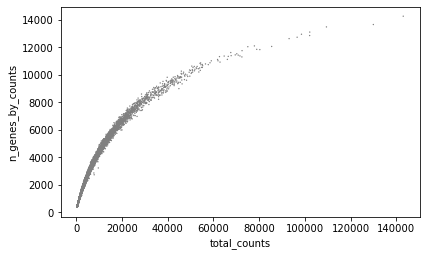

full 100% rescue first phase QC


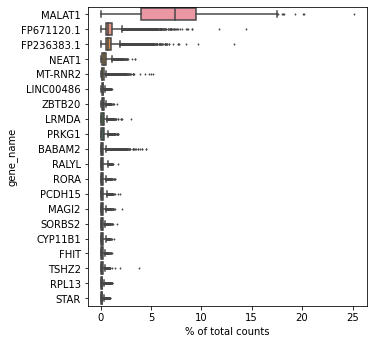

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

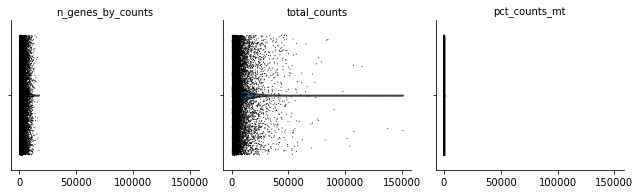

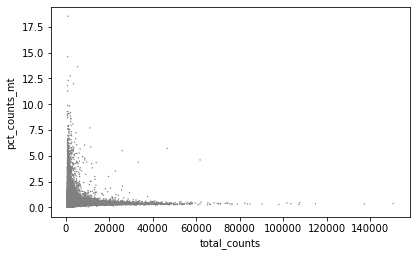

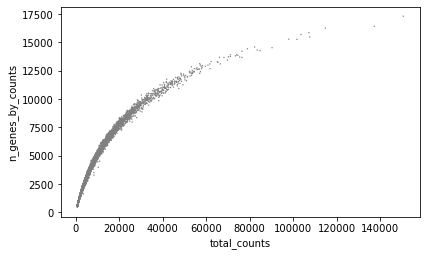

full 50% rescue first phase QC


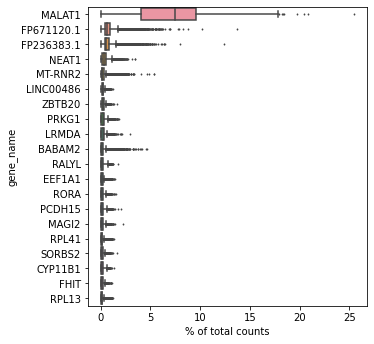

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

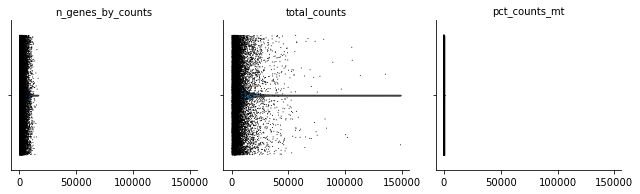

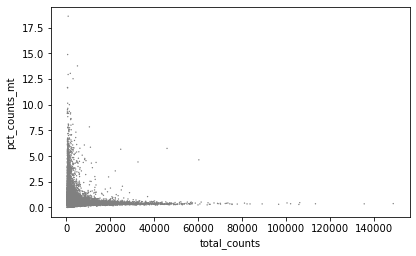

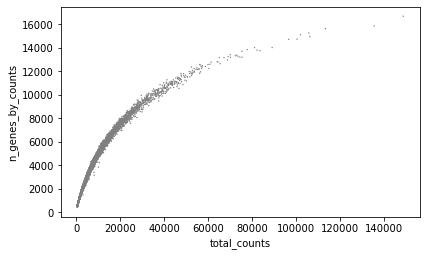

minimal 100% rescue first phase QC


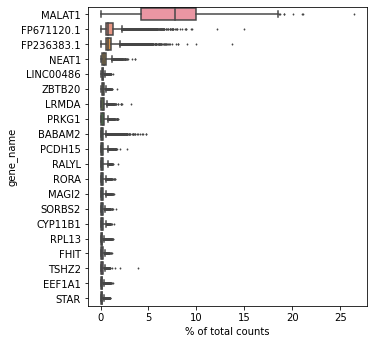

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

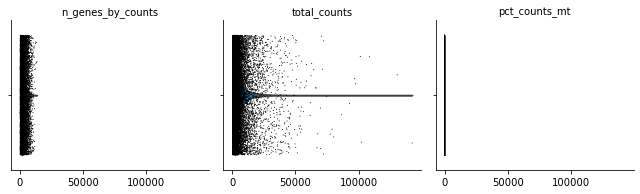

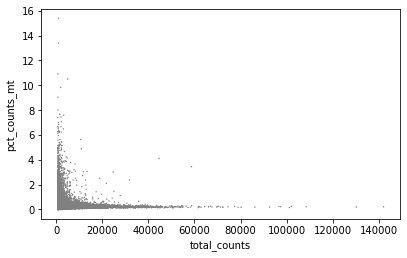

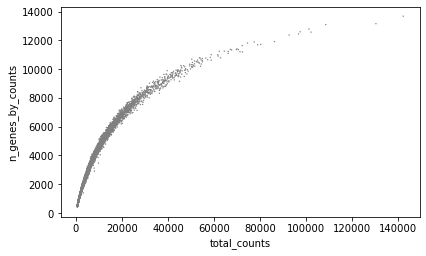

minimal 50% rescue first phase QC


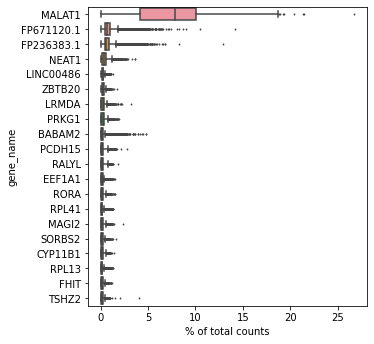

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

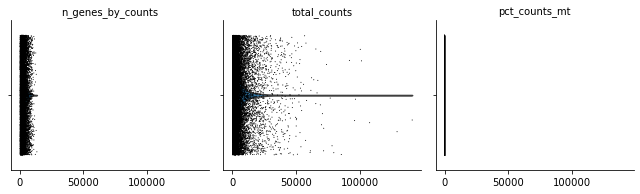

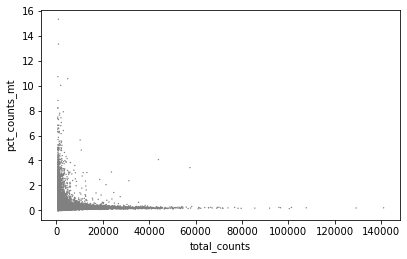

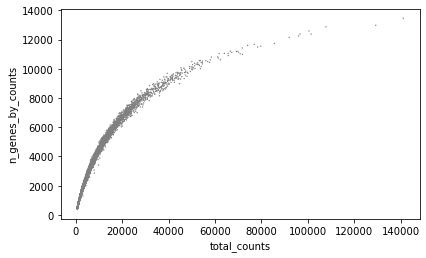

tenx 100% rescue first phase QC


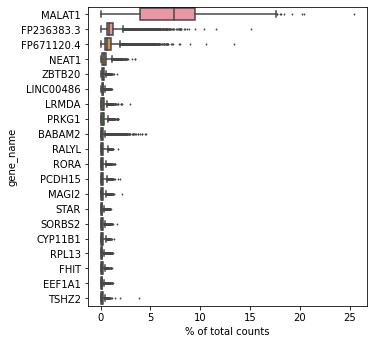

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

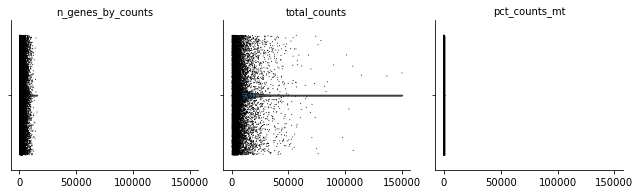

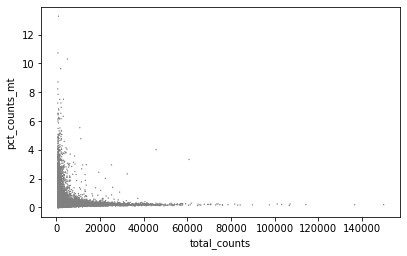

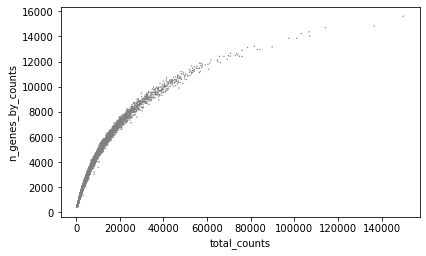

tenx 50% recscue first phase QC


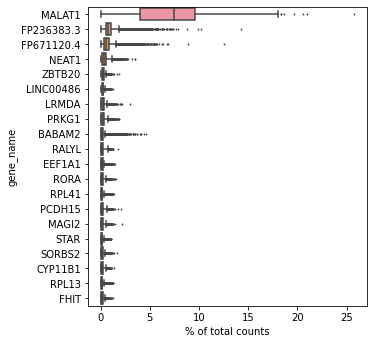

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

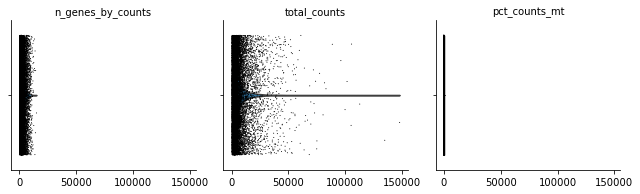

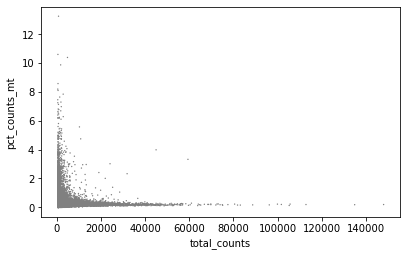

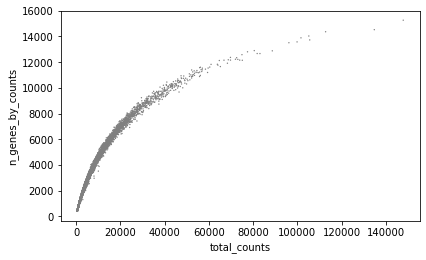

full 100% em first phase QC


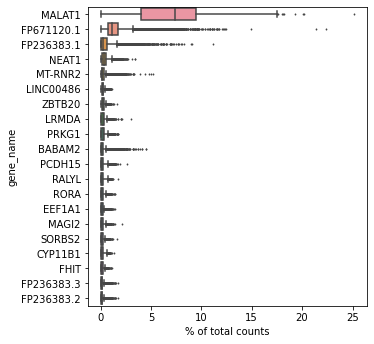

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

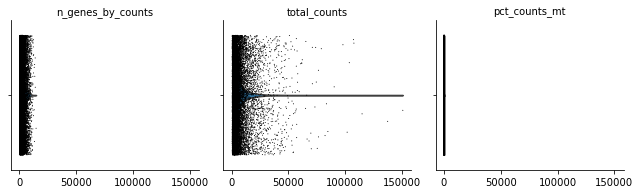

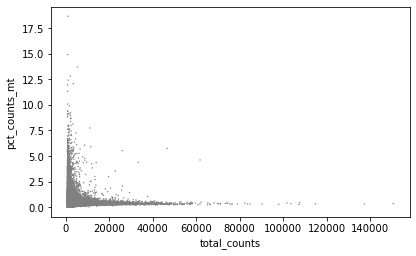

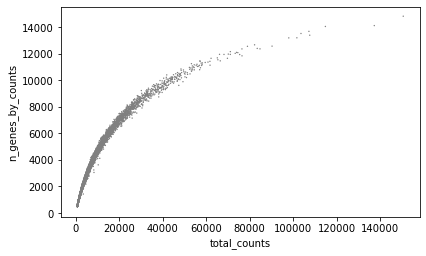

full 50% em first phase QC


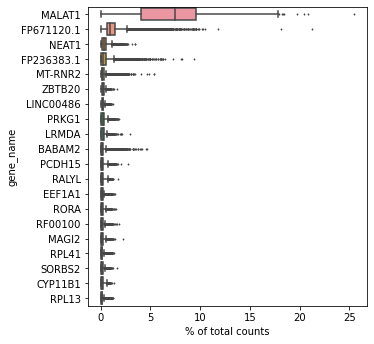

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

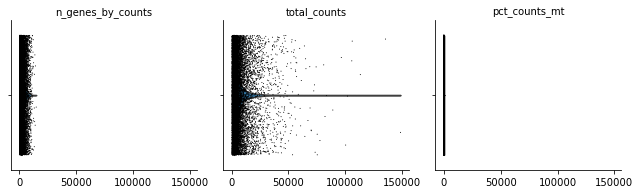

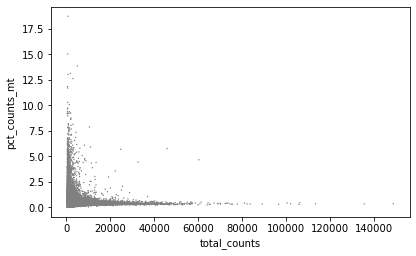

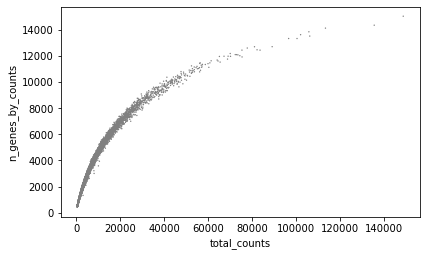

minimal 100% em first phase QC


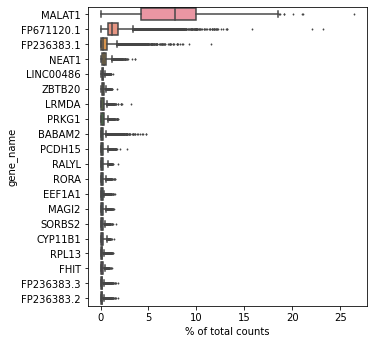

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

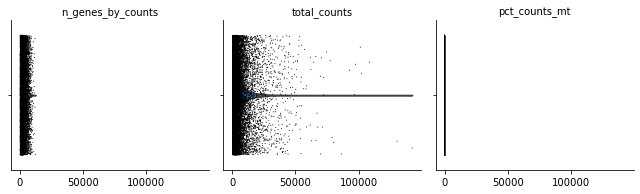

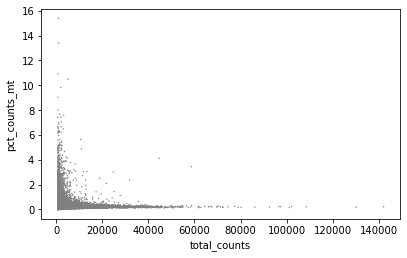

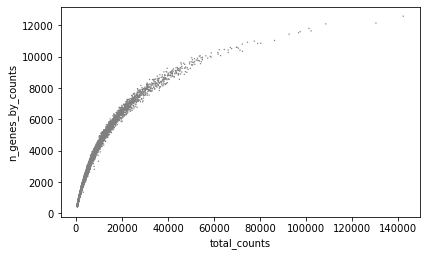

minimal 50% em first phase QC


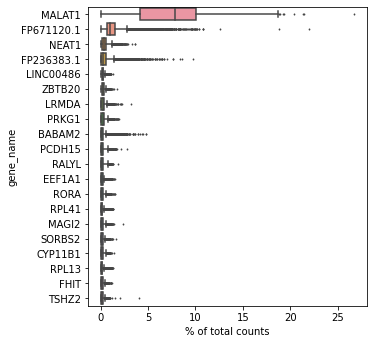

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

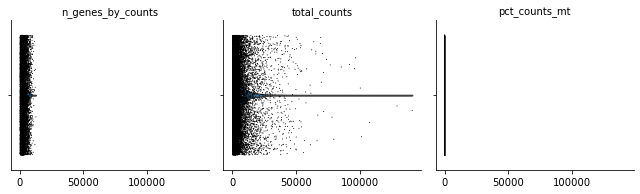

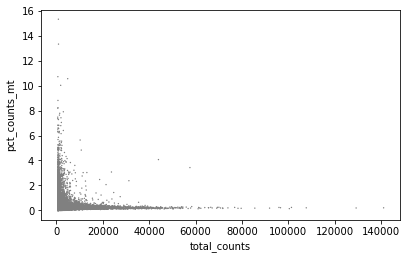

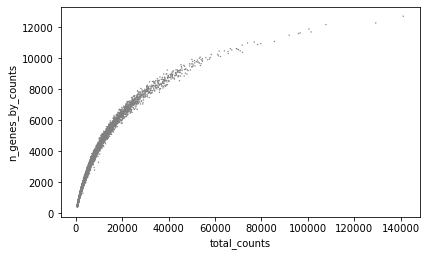

tenx 100% em first phase QC


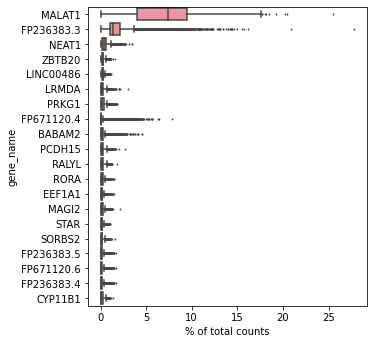

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

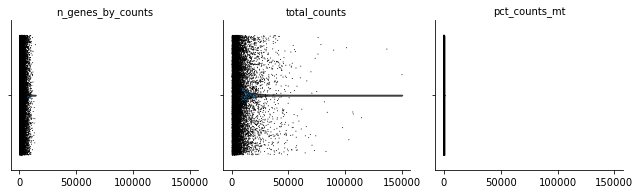

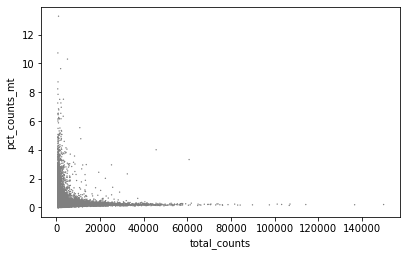

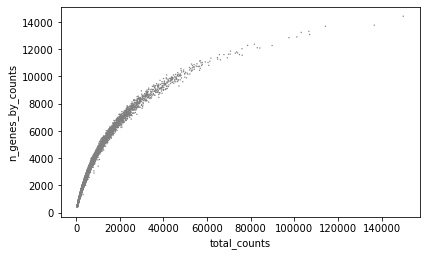

tenx 50% em first phase QC


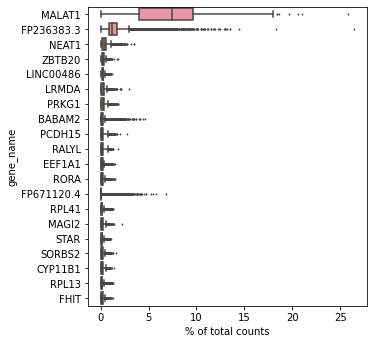

... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/

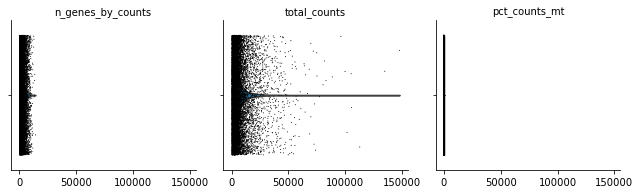

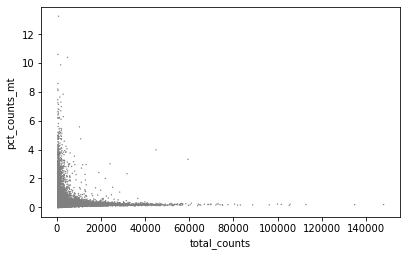

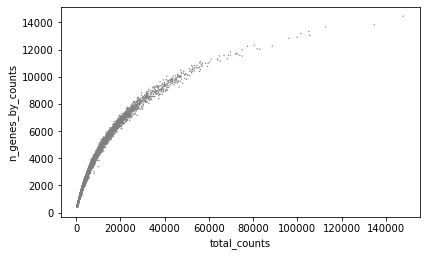

In [17]:
for algorithm in algorithm_filtered:
    print("{algorithm} first phase QC".format(algorithm=algorithm))    
    if algorithm.startswith("tenx"):
        algorithm_filtered[algorithm].var['gene_name'] = [v32m_gene_id_to_name.get(x, x) for x in  algorithm_filtered[algorithm].var_names]
        algorithm_filtered[algorithm].var['gene_type'] = [v32m_gene_id_to_type.get(x, x) for x in  algorithm_filtered[algorithm].var_names]
    else:
        algorithm_filtered[algorithm].var['gene_name'] = [v29_gene_id_to_name.get(x, x) for x in  algorithm_filtered[algorithm].var_names]
        algorithm_filtered[algorithm].var['gene_type'] = [v29_gene_id_to_type.get(x, x) for x in  algorithm_filtered[algorithm].var_names]
        
    scanpy.pl.highest_expr_genes(algorithm_filtered[algorithm], n_top=20, gene_symbols='gene_name')
    scanpy.pp.filter_cells(algorithm_filtered[algorithm], min_genes=200)
    scanpy.pp.filter_genes(algorithm_filtered[algorithm], min_cells=3)
    algorithm_filtered[algorithm].var['mt'] = algorithm_filtered[algorithm].var['gene_name'].str.startswith("MT-")
    scanpy.pp.calculate_qc_metrics(algorithm_filtered[algorithm], qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    scanpy.pl.violin(
        algorithm_filtered[algorithm],
        ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
        jitter=0.4, multi_panel=True)
    scanpy.pl.scatter(algorithm_filtered[algorithm], x='total_counts', y='pct_counts_mt')
    scanpy.pl.scatter(algorithm_filtered[algorithm], x='total_counts', y='n_genes_by_counts')        

full 100% uniq clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


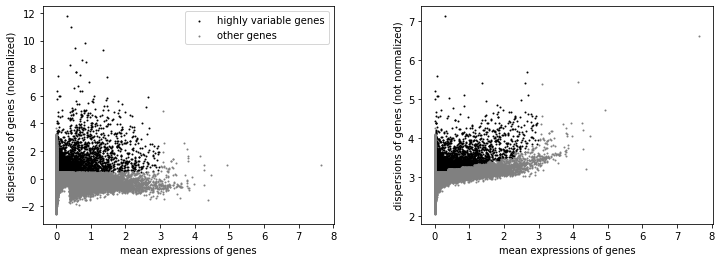

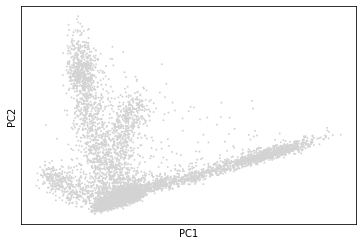

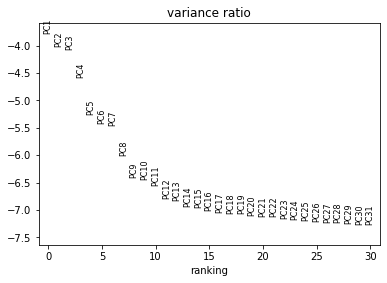

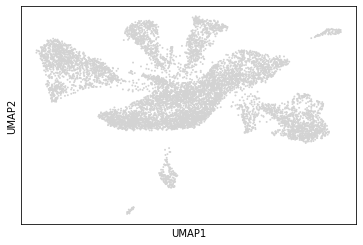

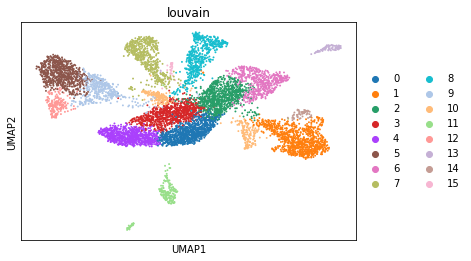

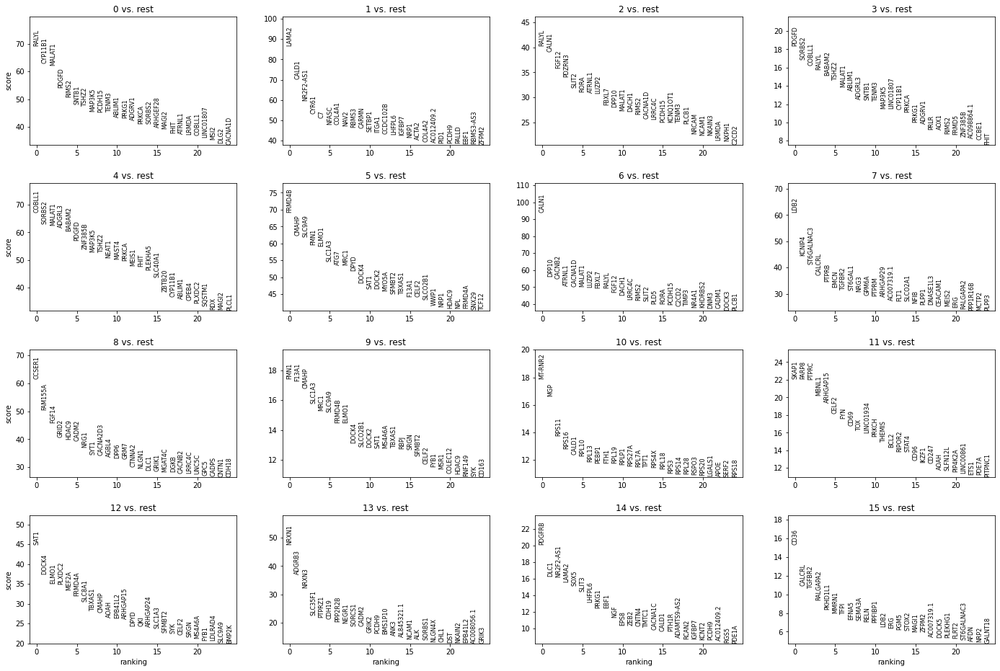

top gene names
         0          1       2       3       4       5        6           7  \
0    RALYL      LAMA2   RALYL   PDGFD  COBLL1  FRMD4B    CALN1        LDB2   
1  CYP11B1      CALD1   CALN1  SORBS2  SORBS2   CMAHP    DPP10      KCNIP4   
2   MALAT1  NR2F2-AS1   FGF12  COBLL1  MALAT1  SLC9A9   CACNB2  ST6GALNAC3   
3    PDGFD      CYR61  PDZRN3   RALYL  ADGRL3    FMN1   ATRNL1      CALCRL   
4    RIMS2         C7   SLIT2  BABAM2  BABAM2   ELMO1  CACNA1D       PTPRB   

         8       9       10        11      12       13         14        15  
0   CCSER1    FMN1  MT-RNR2     SKAP1    SAT1    NRXN1     PDGFRB      CD36  
1  FAM155A   F13A1      MGP     PARP8   DOCK4   ADGRB3       DLC1    CALCRL  
2    FGF14   CMAHP    RPS11     PTPRC   ELMO1    NRXN3  NR2F2-AS1    TGFBR2  
3    GRID2  SLC1A3    RPS16     MBNL1  PLXDC2  SLC35F1      LAMA2  RALGAPA2  
4    HDAC9    MRC1    CALD1  ARHGAP15   MEF2A   PTPRZ1       SOX5   PKHD1L1  
full 50% uniq clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


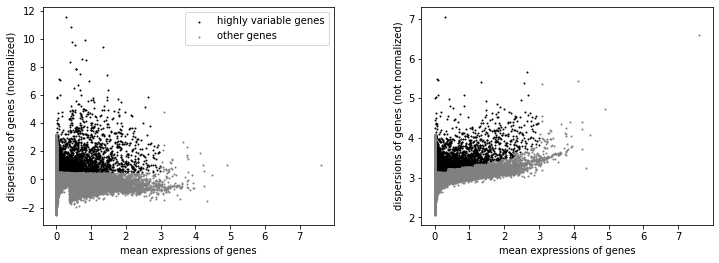

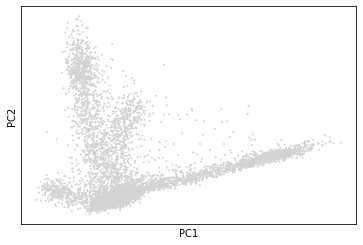

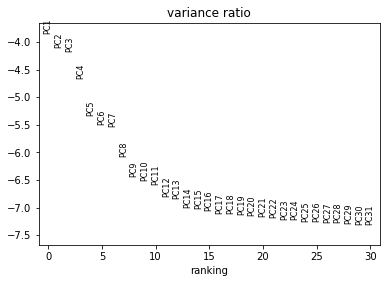

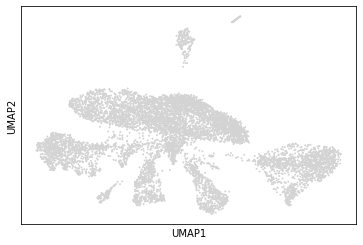

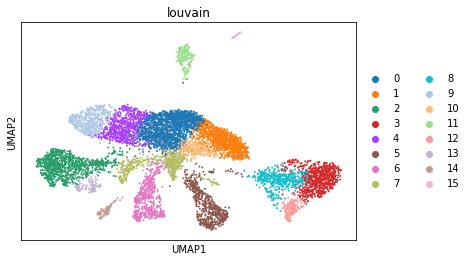

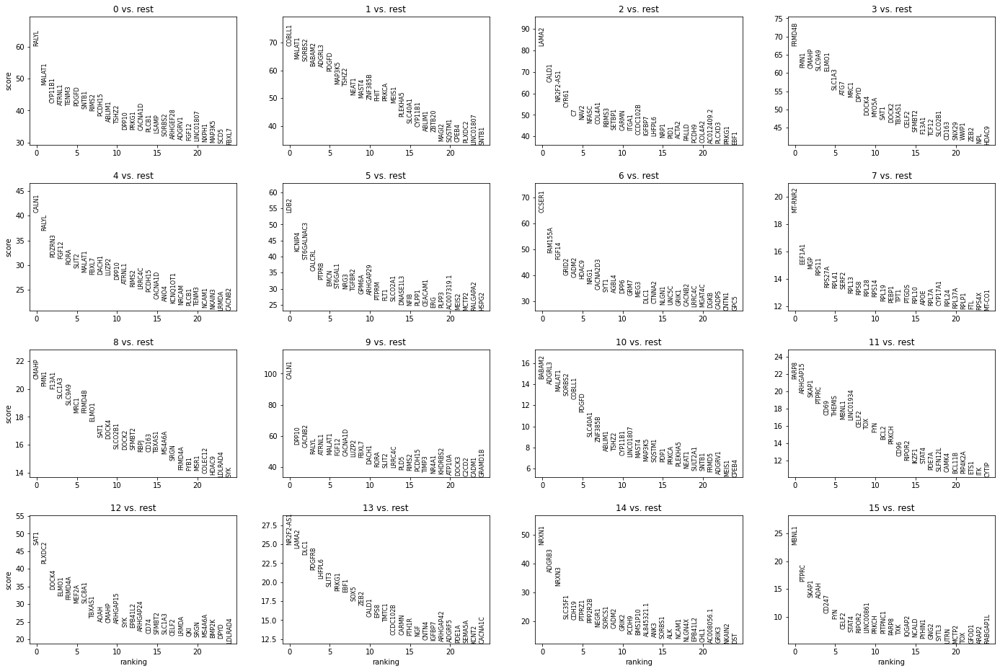

top gene names
         0       1          2       3       4           5        6        7  \
0    RALYL  COBLL1      LAMA2  FRMD4B   CALN1        LDB2   CCSER1  MT-RNR2   
1   MALAT1  MALAT1      CALD1    FMN1   RALYL      KCNIP4  FAM155A   EEF1A1   
2  CYP11B1  SORBS2  NR2F2-AS1   CMAHP  PDZRN3  ST6GALNAC3    FGF14      MGP   
3   ATRNL1  BABAM2      CYR61  SLC9A9   FGF12      CALCRL    GRID2    RPS11   
4    TENM3  ADGRL3         C7   ELMO1    RORA       PTPRB    CADM2   RPS27A   

        8       9      10        11      12         13       14     15  
0   CMAHP   CALN1  BABAM2     PARP8    SAT1  NR2F2-AS1    NRXN1  MBNL1  
1    FMN1   DPP10  ADGRL3  ARHGAP15  PLXDC2      LAMA2   ADGRB3  PTPRC  
2   F13A1  CACNB2  MALAT1     SKAP1   DOCK4       DLC1    NRXN3  SKAP1  
3  SLC1A3   RALYL  SORBS2     PTPRC   ELMO1     PDGFRB  SLC35F1   AOAH  
4  SLC9A9  ATRNL1  COBLL1      CD69  FRMD4A     LHFPL6    CDH19  CD247  
minimal 100% uniq clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


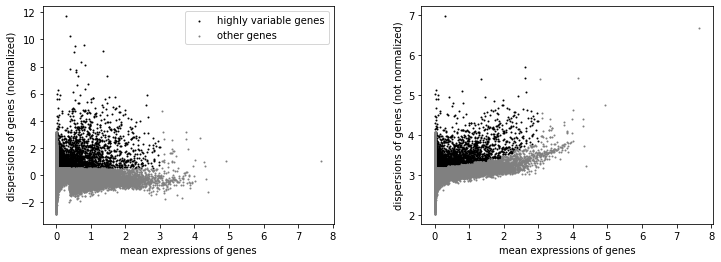

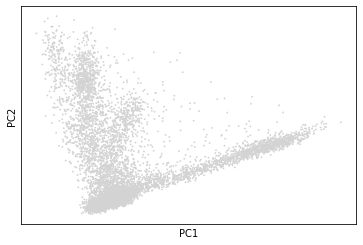

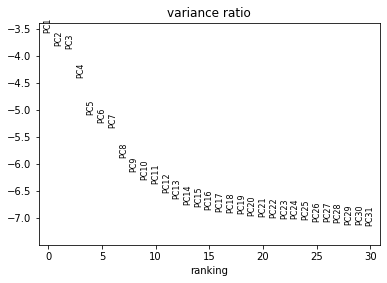

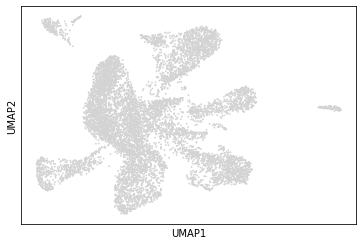

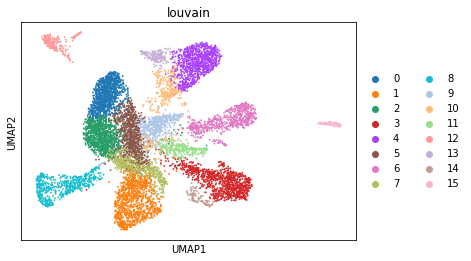

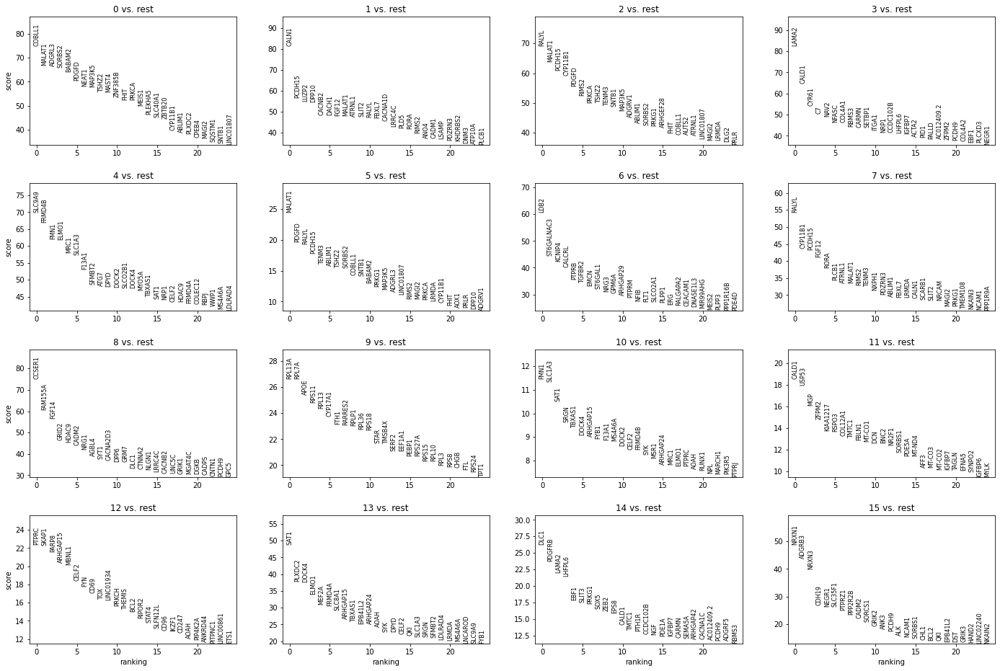

top gene names
        0       1        2      3       4       5           6        7  \
0  COBLL1   CALN1    RALYL  LAMA2  SLC9A9  MALAT1        LDB2    RALYL   
1  MALAT1  PCDH15   MALAT1  CALD1  FRMD4B   PDGFD  ST6GALNAC3  CYP11B1   
2  ADGRL3   LUZP2   PCDH15  CYR61    FMN1   RALYL      KCNIP4   PCDH15   
3  SORBS2   DPP10  CYP11B1     C7   ELMO1  PCDH15      CALCRL    FGF12   
4  BABAM2  CACNB2    PDGFD   NAV2    MRC1   TENM3       PTPRB     RORA   

         8       9      10        11        12      13      14      15  
0   CCSER1  RPL13A    FMN1     CALD1     PTPRC    SAT1    DLC1   NRXN1  
1  FAM155A   RPL7A  SLC1A3     USP53     SKAP1  PLXDC2  PDGFRB  ADGRB3  
2    FGF14    APOE    SAT1       MGP     PARP8   DOCK4   LAMA2   NRXN3  
3    GRID2   RPS11    SRGN     ZFPM2  ARHGAP15   ELMO1  LHFPL6   CDH19  
4    HDAC9   RPL13  TBXAS1  KIAA1217     MBNL1   MEF2A    EBF1   NEGR1  
minimal 50% uniq clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


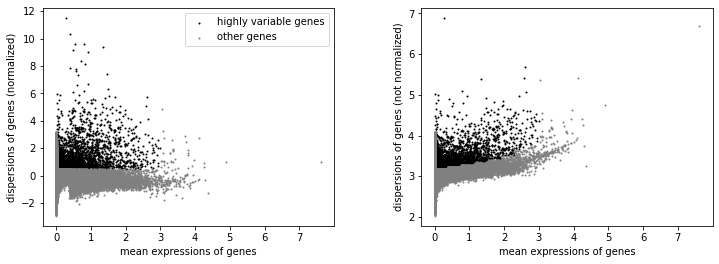

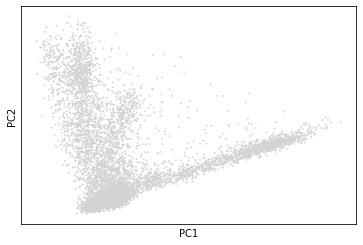

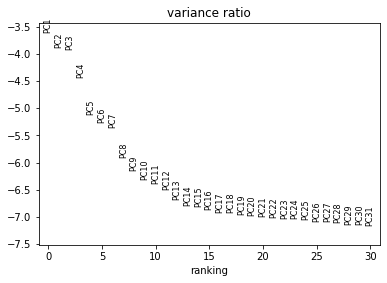

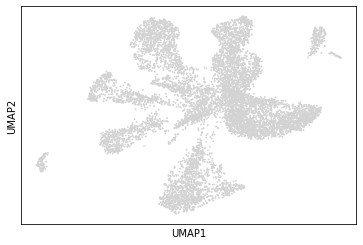

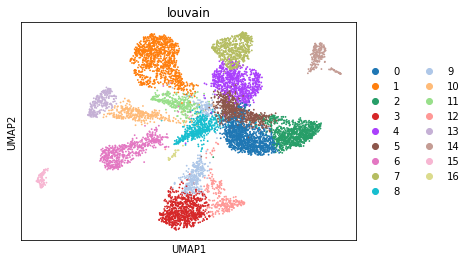

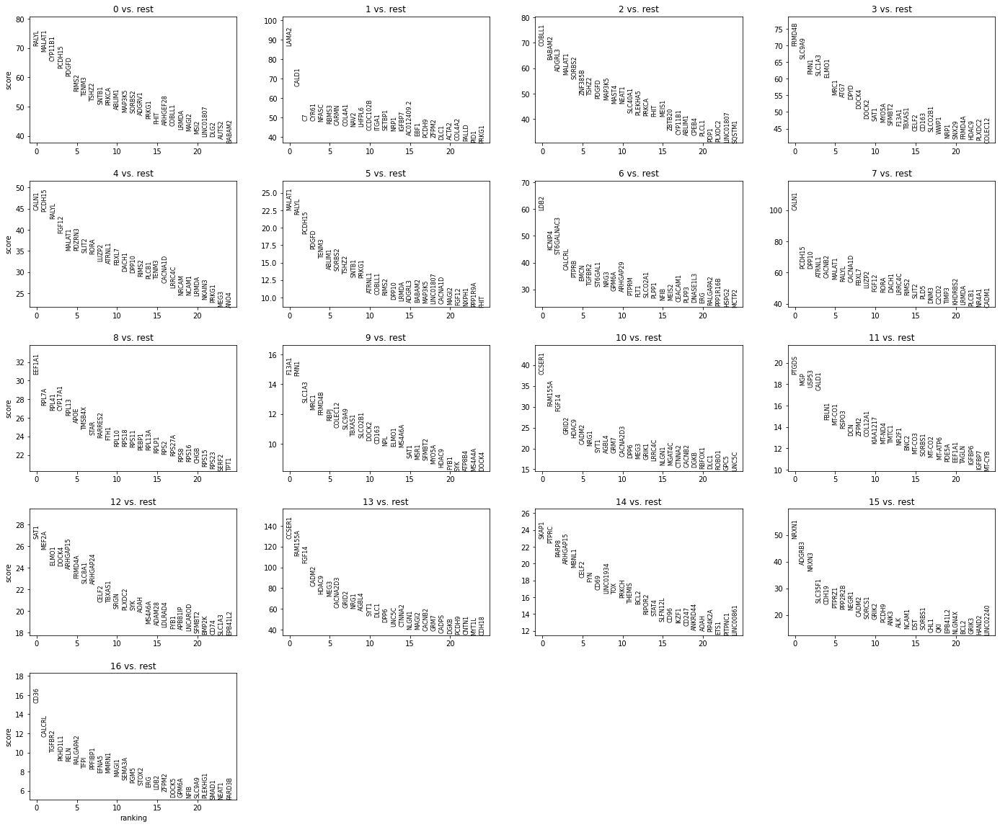

top gene names
         0      1       2       3       4       5           6       7  \
0    RALYL  LAMA2  COBLL1  FRMD4B   CALN1  MALAT1        LDB2   CALN1   
1   MALAT1  CALD1  BABAM2  SLC9A9  PCDH15   RALYL      KCNIP4  PCDH15   
2  CYP11B1     C7  ADGRL3    FMN1   RALYL  PCDH15  ST6GALNAC3   DPP10   
3   PCDH15  CYR61  MALAT1  SLC1A3   FGF12   PDGFD      CALCRL  ATRNL1   
4    PDGFD  NFASC  SORBS2   ELMO1  MALAT1   TENM3       PTPRB  CACNB2   

         8       9       10     11        12       13        14       15  \
0   EEF1A1   F13A1   CCSER1  PTGDS      SAT1   CCSER1     SKAP1    NRXN1   
1    RPL7A    FMN1  FAM155A    MGP     MEF2A  FAM155A     PTPRC   ADGRB3   
2    RPL41  SLC1A3    FGF14  USP53     ELMO1    FGF14     PARP8    NRXN3   
3  CYP17A1    MRC1    GRID2  CALD1     DOCK4    CADM2  ARHGAP15  SLC35F1   
4    RPL13  FRMD4B    HDAC9  FBLN1  ARHGAP15    HDAC9     MBNL1    CDH19   

        16  
0     CD36  
1   CALCRL  
2   TGFBR2  
3  PKHD1L1  
4     RELN  
tenx 100% u

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


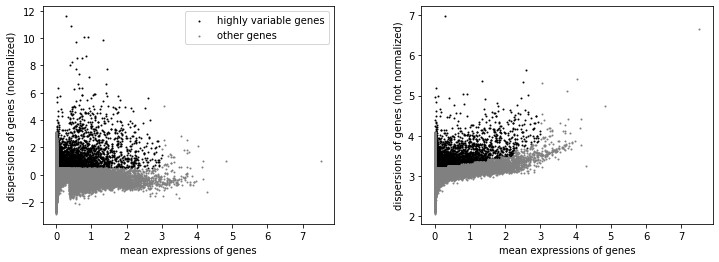

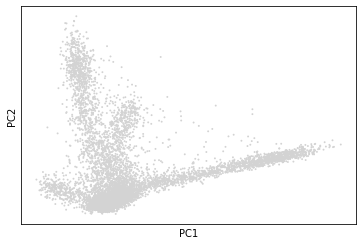

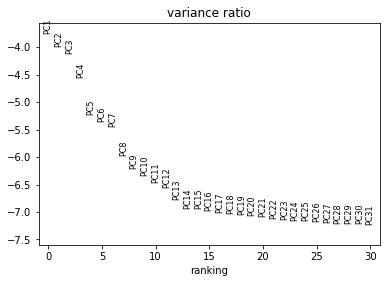

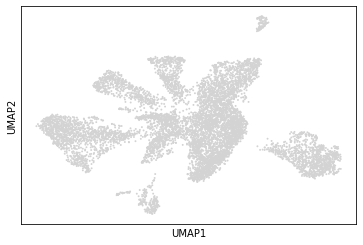

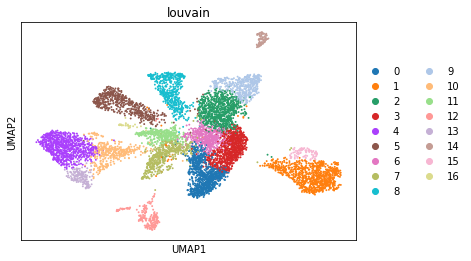

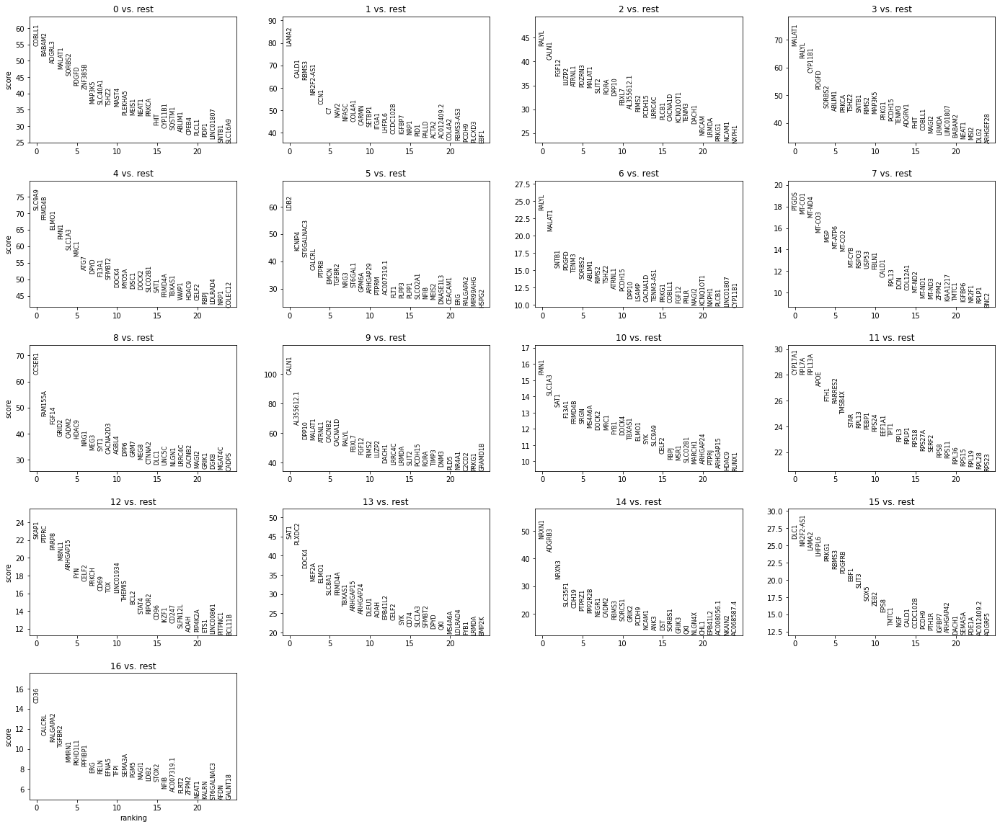

top gene names
        0          1       2        3       4           5       6       7  \
0  COBLL1      LAMA2   RALYL   MALAT1  SLC9A9        LDB2   RALYL   PTGDS   
1  BABAM2      CALD1   CALN1    RALYL  FRMD4B      KCNIP4  MALAT1  MT-CO1   
2  ADGRL3      RBMS3   FGF12  CYP11B1   ELMO1  ST6GALNAC3   SNTB1  MT-ND4   
3  MALAT1  NR2F2-AS1   LUZP2    PDGFD    FMN1      CALCRL   PDGFD  MT-CO3   
4  SORBS2      CYR61  ATRNL1   SORBS2  SLC1A3       PTPRB   TENM3     MGP   

         8           9      10       11        12      13       14         15  \
0   CCSER1       CALN1    FMN1  CYP17A1     SKAP1    SAT1    NRXN1       DLC1   
1  FAM155A  AL590426.2  SLC1A3    RPL7A     PTPRC  PLXDC2   ADGRB3  NR2F2-AS1   
2    FGF14       DPP10    SAT1   RPL13A     PARP8   DOCK4    NRXN3      LAMA2   
3    GRID2      MALAT1   F13A1     APOE     MBNL1   MEF2A  SLC35F1     LHFPL6   
4    CADM2      ATRNL1  FRMD4B     FTH1  ARHGAP15   ELMO1    CDH19      PRKG1   

         16  
0      CD36  
1    CA

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


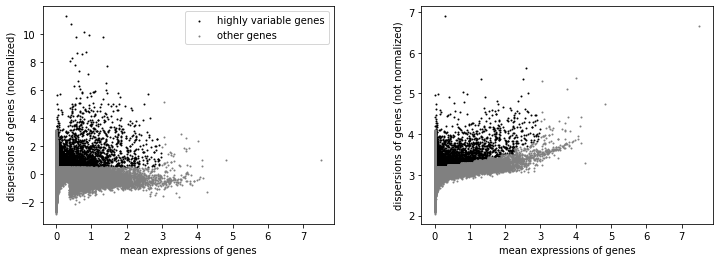

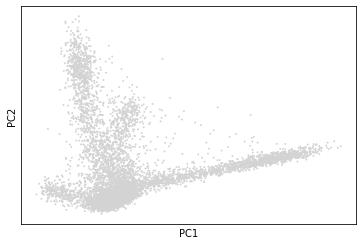

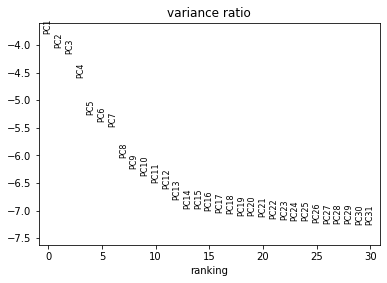

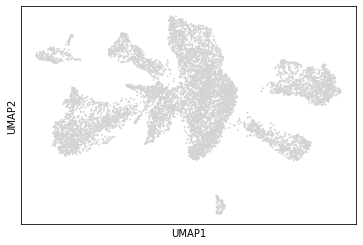

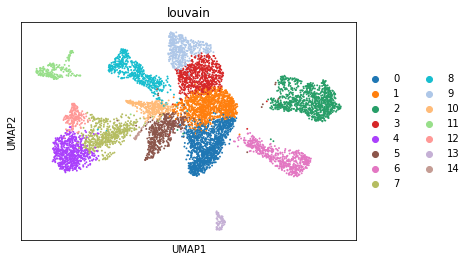

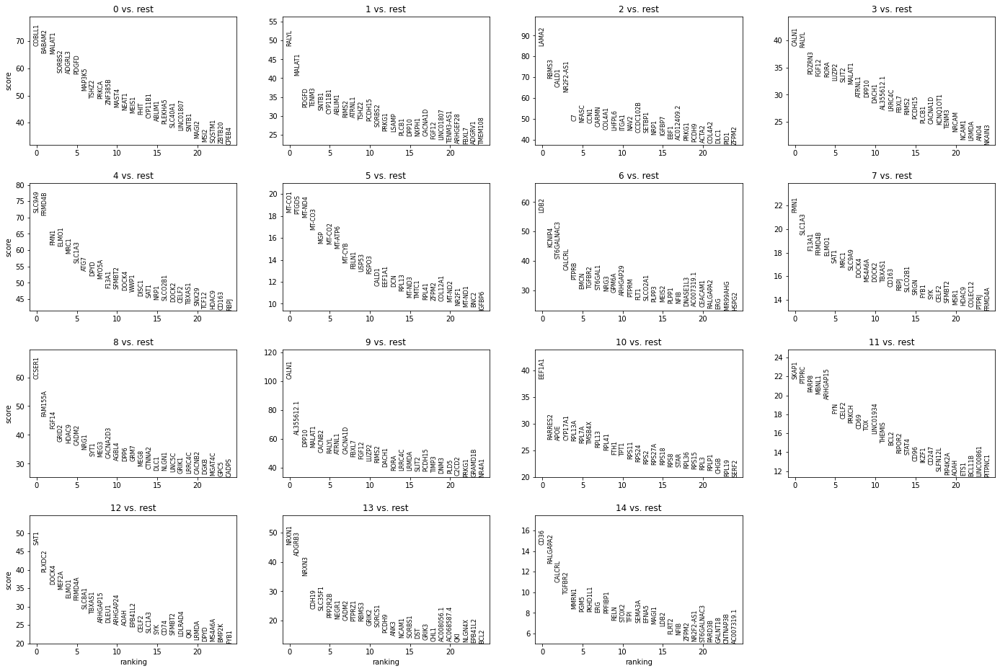

top gene names
        0       1          2       3       4       5           6       7  \
0  COBLL1   RALYL      LAMA2   CALN1  SLC9A9  MT-CO1        LDB2    FMN1   
1  BABAM2  MALAT1      RBMS3   RALYL  FRMD4B   PTGDS      KCNIP4  SLC1A3   
2  MALAT1   PDGFD      CALD1  PDZRN3    FMN1  MT-ND4  ST6GALNAC3   F13A1   
3  SORBS2   TENM3  NR2F2-AS1   FGF12   ELMO1  MT-CO3      CALCRL  FRMD4B   
4  ADGRL3   SNTB1         C7    RORA    MRC1     MGP       PTPRB   ELMO1   

         8           9       10        11      12       13        14  
0   CCSER1       CALN1   EEF1A1     SKAP1    SAT1    NRXN1      CD36  
1  FAM155A  AL590426.2  RARRES2     PTPRC  PLXDC2   ADGRB3  RALGAPA2  
2    FGF14       DPP10     APOE     PARP8   DOCK4    NRXN3    CALCRL  
3    GRID2      MALAT1  CYP17A1     MBNL1   MEF2A    CDH19    TGFBR2  
4    HDAC9      CACNB2   RPL13A  ARHGAP15   ELMO1  SLC35F1     MMRN1  
full 100% rescue clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


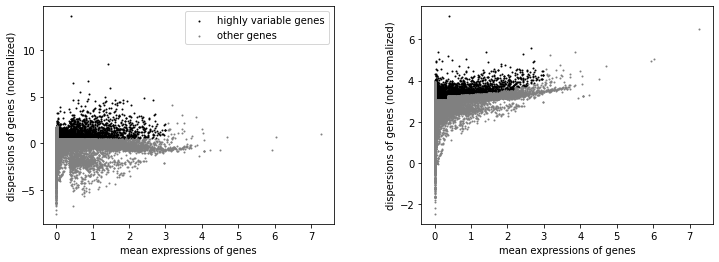

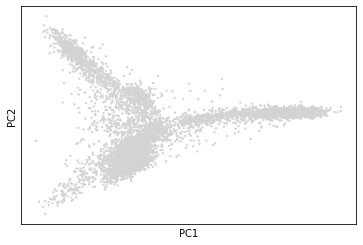

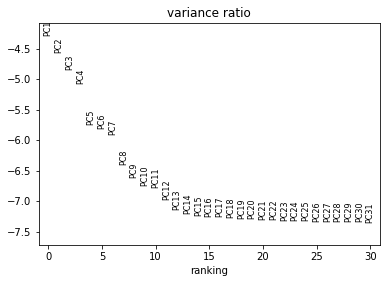

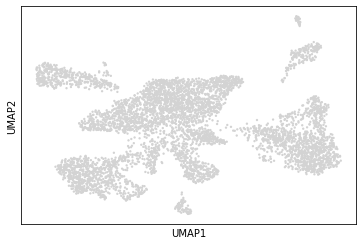

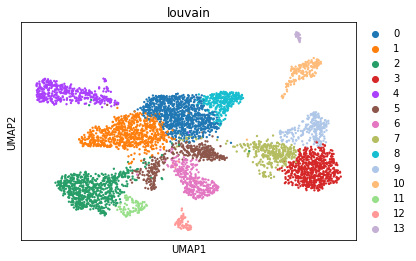

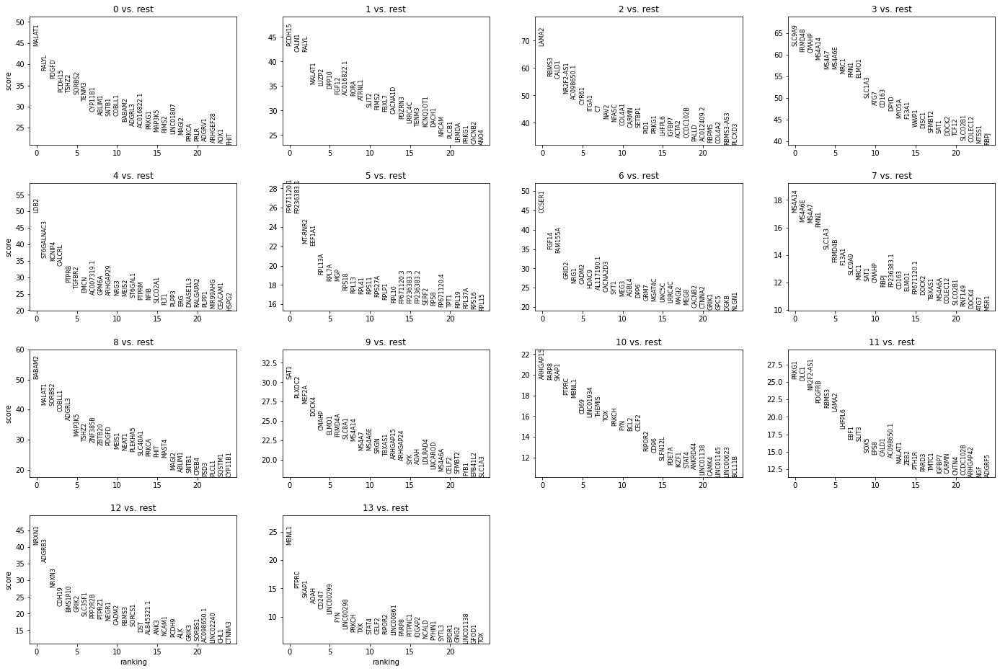

top gene names
        0       1           2       3           4           5        6  \
0  MALAT1  PCDH15       LAMA2  SLC9A9        LDB2  FP671120.1   CCSER1   
1   RALYL   CALN1       RBMS3  FRMD4B  ST6GALNAC3  FP236383.1    FGF14   
2   PDGFD   RALYL       CALD1   CMAHP      KCNIP4     MT-RNR2  FAM155A   
3  PCDH15  MALAT1   NR2F2-AS1  MS4A14      CALCRL      EEF1A1    GRID2   
4   TSHZ2   LUZP2  AC098650.1   MS4A7       PTPRB      RPL13A     NRG1   

        7       8       9        10         11       12     13  
0  MS4A14  BABAM2    SAT1  ARHGAP15      PRKG1    NRXN1  MBNL1  
1  MS4A6E  MALAT1  PLXDC2     PARP8       DLC1   ADGRB3  PTPRC  
2   MS4A7  SORBS2   MEF2A     SKAP1  NR2F2-AS1    NRXN3  SKAP1  
3    FMN1  COBLL1   DOCK4     PTPRC     PDGFRB    CDH19   AOAH  
4  SLC1A3  ADGRL3   CMAHP     MBNL1      RBMS3  BMS1P10  CD247  
full 50% rescue clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


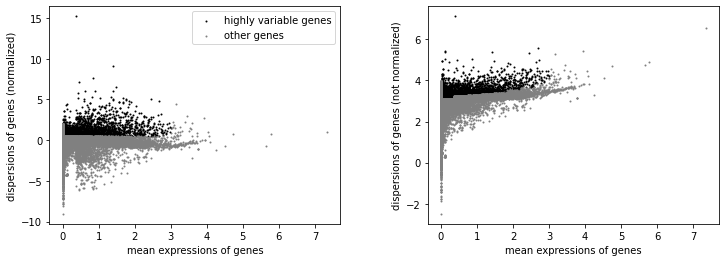

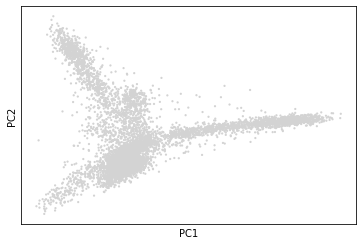

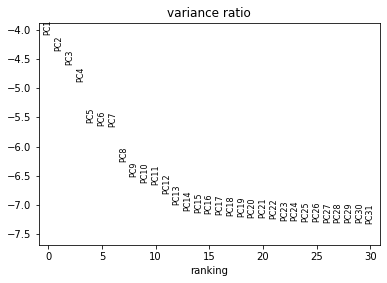

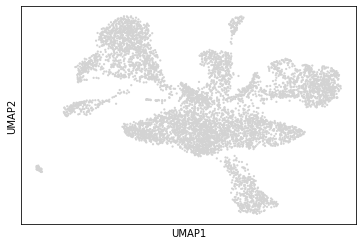

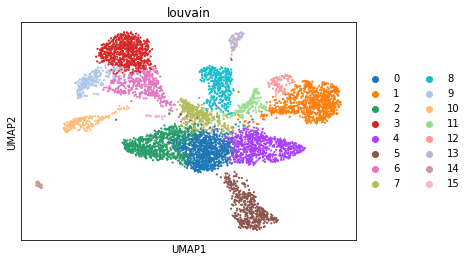

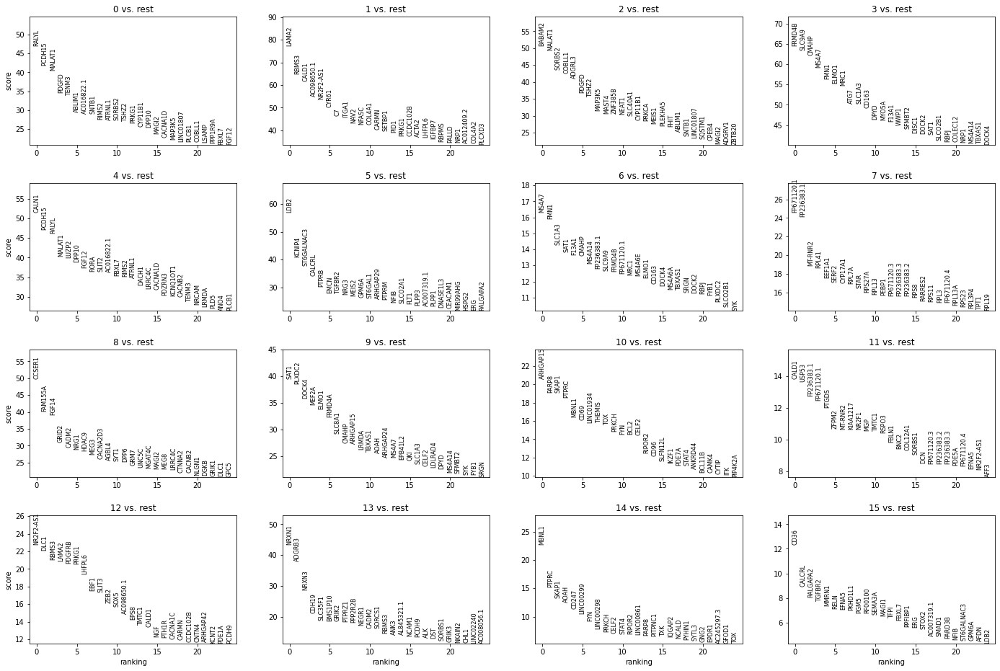

top gene names
        0           1       2       3       4           5       6           7  \
0   RALYL       LAMA2  BABAM2  FRMD4B   CALN1        LDB2   MS4A7  FP671120.1   
1  PCDH15       RBMS3  MALAT1  SLC9A9  PCDH15      KCNIP4    FMN1  FP236383.1   
2  MALAT1       CALD1  SORBS2   CMAHP   RALYL  ST6GALNAC3  SLC1A3     MT-RNR2   
3   PDGFD  AC098650.1  COBLL1   MS4A7  MALAT1      CALCRL    SAT1       RPL41   
4   TENM3   NR2F2-AS1  ADGRL3    FMN1   LUZP2       PTPRB   F13A1      EEF1A1   

         8       9        10          11         12       13     14        15  
0   CCSER1    SAT1  ARHGAP15       CALD1  NR2F2-AS1    NRXN1  MBNL1      CD36  
1  FAM155A  PLXDC2     PARP8       USP53       DLC1   ADGRB3  PTPRC    CALCRL  
2    FGF14   DOCK4     SKAP1  FP236383.1      RBMS3    NRXN3  SKAP1  RALGAPA2  
3    GRID2   MEF2A     PTPRC  FP671120.1      LAMA2    CDH19   AOAH    TGFBR2  
4    CADM2   ELMO1     MBNL1       PTGDS     PDGFRB  SLC35F1  CD247     MMRN1  
minimal 100% rescu

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


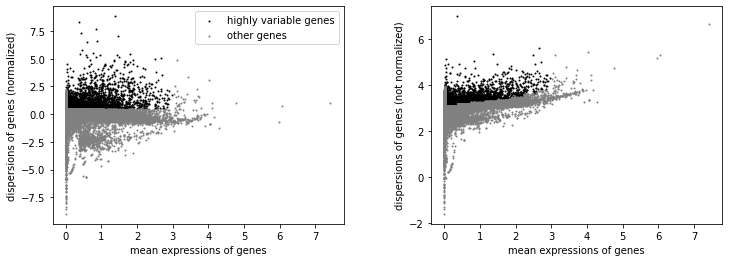

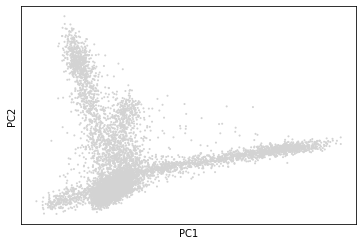

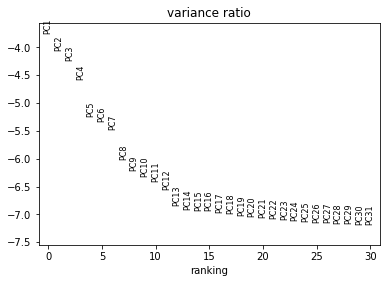

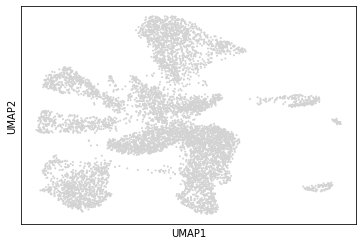

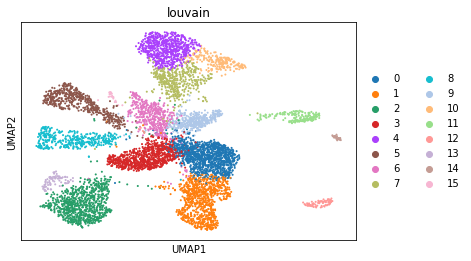

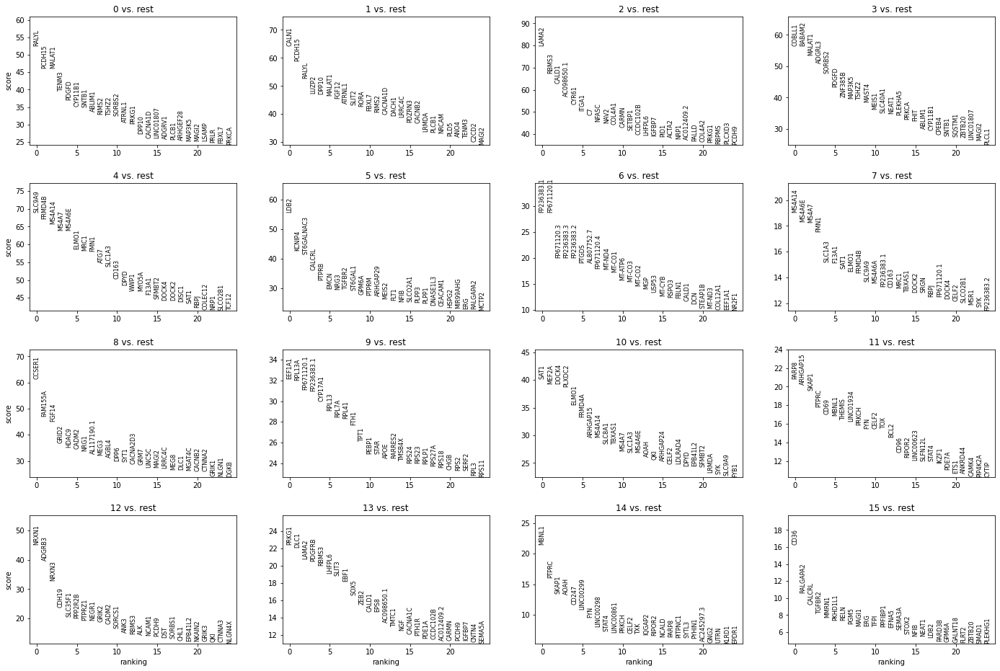

top gene names
        0       1           2       3       4           5           6       7  \
0   RALYL   CALN1       LAMA2  COBLL1  SLC9A9        LDB2  FP236383.1  MS4A14   
1  PCDH15  PCDH15       RBMS3  BABAM2  FRMD4B      KCNIP4  FP671120.1  MS4A6E   
2  MALAT1   RALYL       CALD1  MALAT1  MS4A14  ST6GALNAC3  FP671120.3   MS4A7   
3   TENM3   LUZP2  AC098650.1  ADGRL3   MS4A7      CALCRL  FP236383.3    FMN1   
4   PDGFD   DPP10       CYR61  SORBS2  MS4A6E       PTPRB  FP236383.2  SLC1A3   

         8           9      10        11       12      13     14        15  
0   CCSER1      EEF1A1    SAT1     PARP8    NRXN1   PRKG1  MBNL1      CD36  
1  FAM155A      RPL13A   MEF2A  ARHGAP15   ADGRB3    DLC1  PTPRC  RALGAPA2  
2    FGF14  FP671120.1   DOCK4     SKAP1    NRXN3   LAMA2  SKAP1    CALCRL  
3    GRID2  FP236383.1  PLXDC2     PTPRC    CDH19  PDGFRB   AOAH    TGFBR2  
4    HDAC9     CYP17A1   ELMO1      CD69  SLC35F1   RBMS3  CD247     MMRN1  
minimal 50% rescue clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


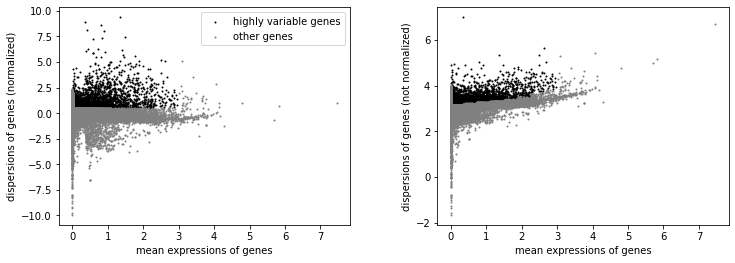

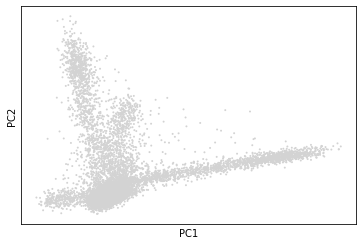

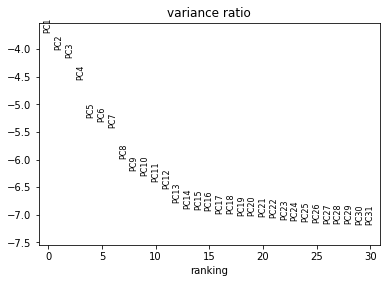

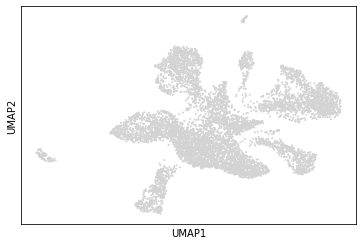

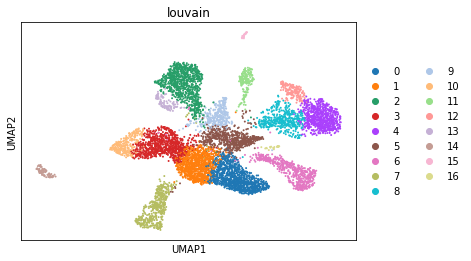

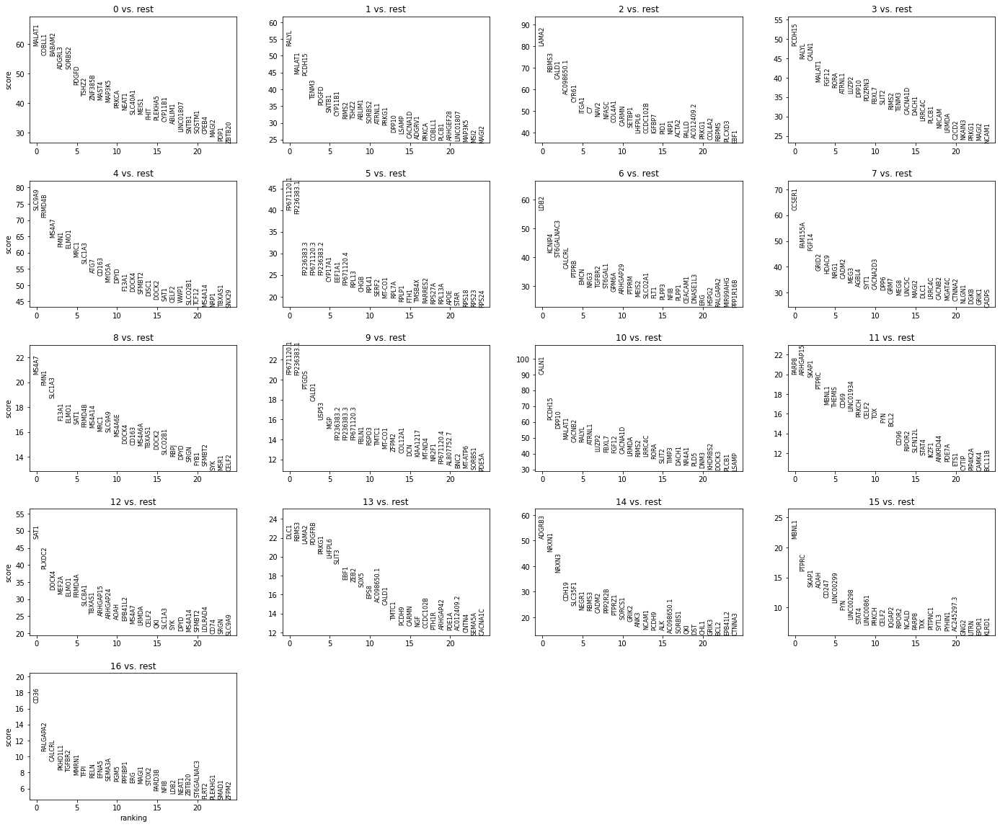

top gene names
        0       1           2       3       4           5           6  \
0  MALAT1   RALYL       LAMA2  PCDH15  SLC9A9  FP671120.1        LDB2   
1  COBLL1  MALAT1       RBMS3   RALYL  FRMD4B  FP236383.1      KCNIP4   
2  BABAM2  PCDH15       CALD1   CALN1   MS4A7  FP236383.3  ST6GALNAC3   
3  ADGRL3   TENM3  AC098650.1  MALAT1    FMN1  FP671120.3      CALCRL   
4  SORBS2   PDGFD       CYR61   FGF12   ELMO1  FP236383.2       PTPRB   

         7       8           9      10        11      12      13       14  \
0   CCSER1   MS4A7  FP671120.1   CALN1     PARP8    SAT1    DLC1   ADGRB3   
1  FAM155A    FMN1  FP236383.1  PCDH15  ARHGAP15  PLXDC2   RBMS3    NRXN1   
2    FGF14  SLC1A3       PTGDS   DPP10     SKAP1   DOCK4   LAMA2    NRXN3   
3    GRID2   F13A1       CALD1  MALAT1     PTPRC   MEF2A  PDGFRB    CDH19   
4    HDAC9   ELMO1       USP53  CACNB2     MBNL1   ELMO1   PRKG1  SLC35F1   

      15        16  
0  MBNL1      CD36  
1  PTPRC  RALGAPA2  
2  SKAP1    CALCRL  

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


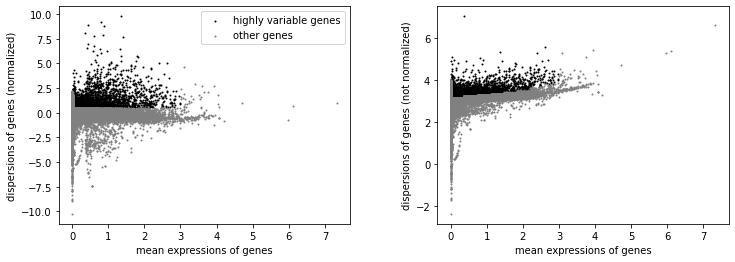

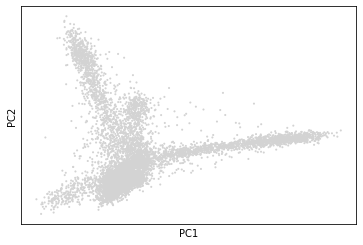

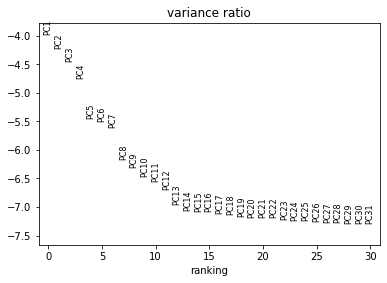

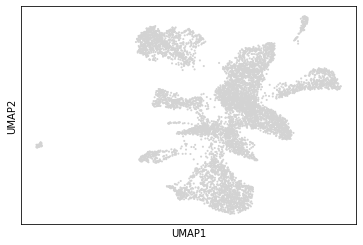

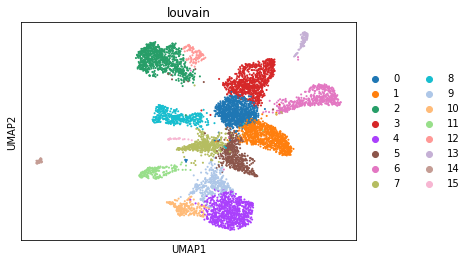

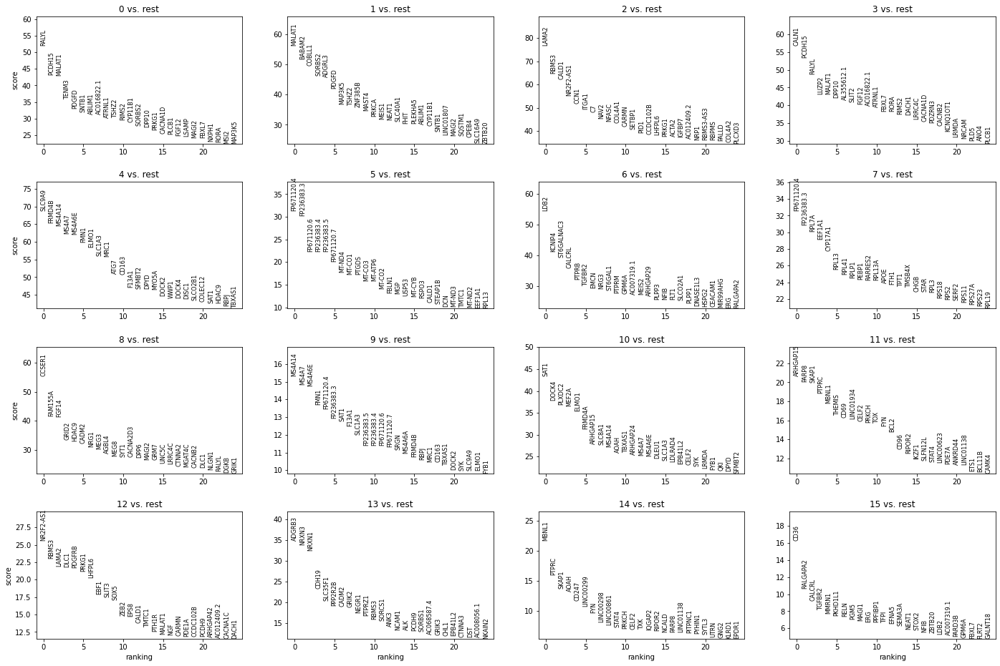

top gene names
        0       1          2       3       4           5           6  \
0   RALYL  MALAT1      LAMA2   CALN1  SLC9A9  FP671120.1        LDB2   
1  PCDH15  BABAM2      RBMS3  PCDH15  FRMD4B  FP236383.1      KCNIP4   
2  MALAT1  COBLL1      CALD1   RALYL  MS4A14  FP671120.3  ST6GALNAC3   
3   TENM3  SORBS2  NR2F2-AS1   LUZP2   MS4A7  FP236383.2      CALCRL   
4   PDGFD  ADGRL3      CYR61  MALAT1  MS4A6E  FP236383.3       PTPRB   

            7        8           9      10        11         12       13  \
0  FP671120.1   CCSER1      MS4A14    SAT1  ARHGAP15  NR2F2-AS1   ADGRB3   
1  FP236383.1  FAM155A       MS4A7   DOCK4     PARP8      RBMS3    NRXN3   
2       RPL7A    FGF14      MS4A6E  PLXDC2     SKAP1      LAMA2    NRXN1   
3      EEF1A1    GRID2        FMN1   MEF2A     PTPRC       DLC1    CDH19   
4     CYP17A1    HDAC9  FP671120.1   ELMO1     MBNL1     PDGFRB  SLC35F1   

      14        15  
0  MBNL1      CD36  
1  PTPRC  RALGAPA2  
2  SKAP1    CALCRL  
3   AOAH   

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


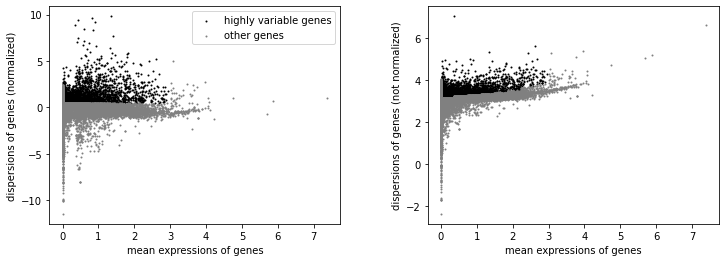

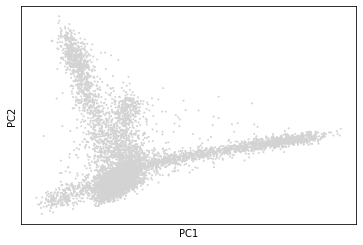

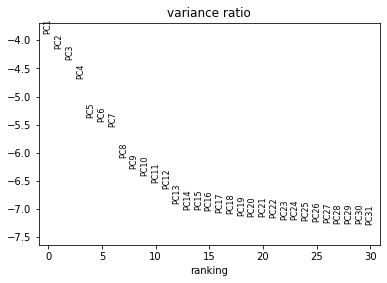

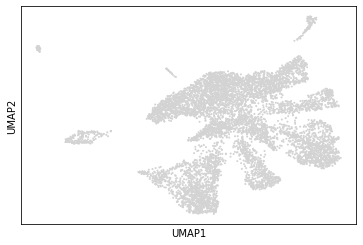

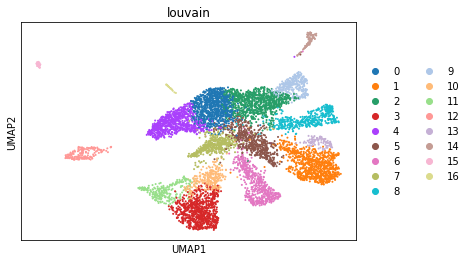

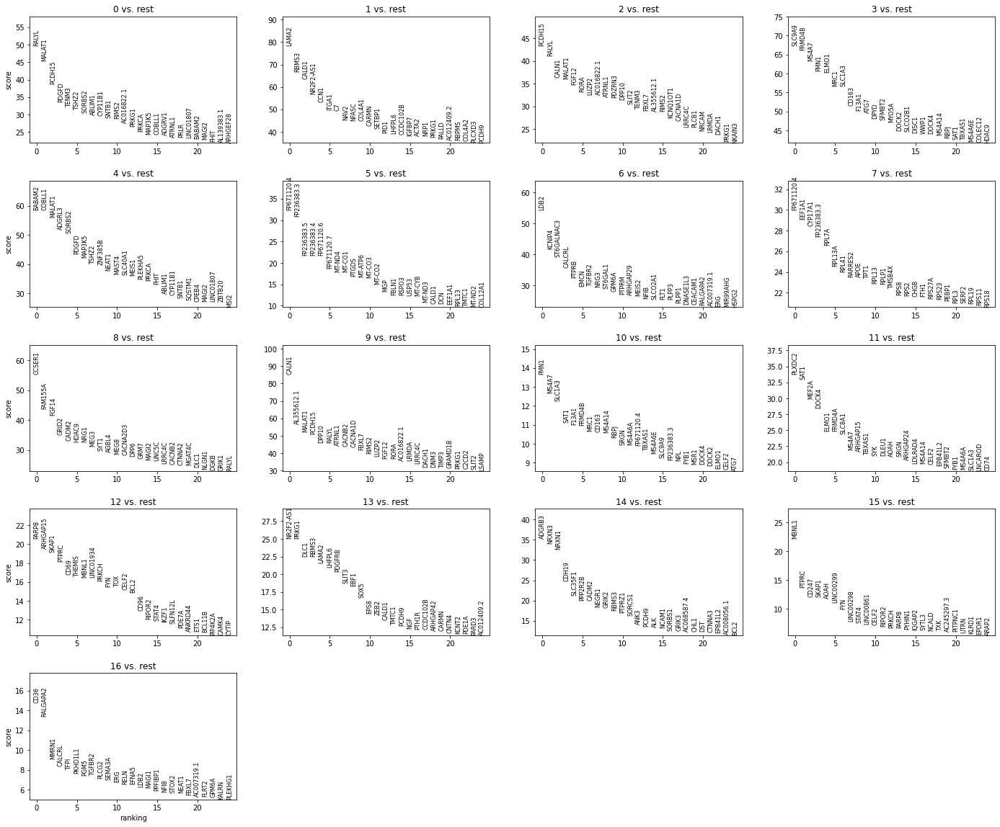

top gene names
        0          1       2       3       4           5           6  \
0   RALYL      LAMA2  PCDH15  SLC9A9  BABAM2  FP671120.1        LDB2   
1  MALAT1      RBMS3   RALYL  FRMD4B  COBLL1  FP236383.1      KCNIP4   
2  PCDH15      CALD1   CALN1   MS4A7  MALAT1  FP236383.3  ST6GALNAC3   
3   PDGFD  NR2F2-AS1  MALAT1    FMN1  ADGRL3  FP236383.2      CALCRL   
4   TENM3      CYR61   FGF12   ELMO1  SORBS2  FP671120.3       PTPRB   

            7        8           9      10      11        12         13  \
0  FP671120.1   CCSER1       CALN1    FMN1  PLXDC2     PARP8  NR2F2-AS1   
1      EEF1A1  FAM155A  AL590426.2   MS4A7    SAT1  ARHGAP15      PRKG1   
2     CYP17A1    FGF14      MALAT1  SLC1A3   MEF2A     SKAP1       DLC1   
3  FP236383.1    GRID2      PCDH15    SAT1   DOCK4     PTPRC      RBMS3   
4       RPL7A    CADM2       DPP10   F13A1   ELMO1      CD69      LAMA2   

        14     15        16  
0   ADGRB3  MBNL1      CD36  
1    NRXN3  PTPRC  RALGAPA2  
2    NRXN1 

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


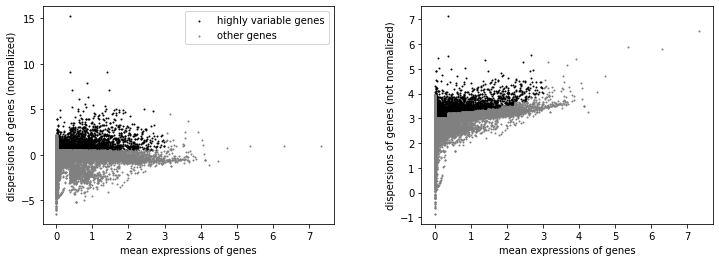

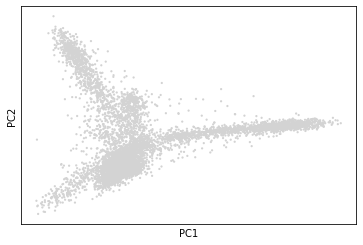

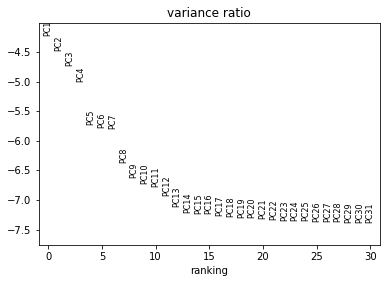

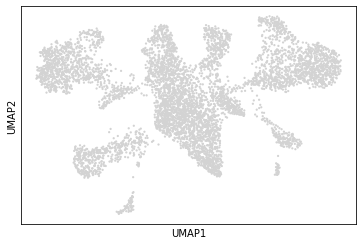

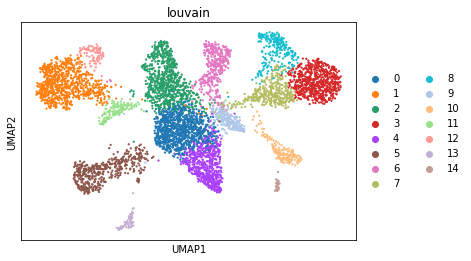

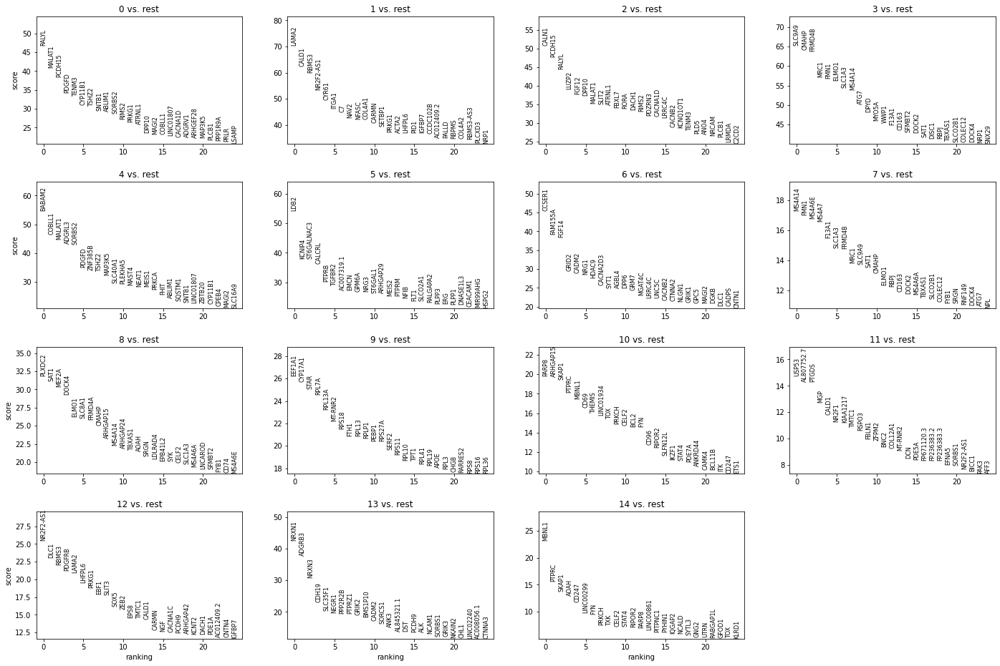

top gene names
        0          1       2       3       4           5        6       7  \
0   RALYL      LAMA2   CALN1  SLC9A9  BABAM2        LDB2   CCSER1  MS4A14   
1  MALAT1      CALD1  PCDH15   CMAHP  COBLL1      KCNIP4  FAM155A    FMN1   
2  PCDH15      RBMS3   RALYL  FRMD4B  MALAT1  ST6GALNAC3    FGF14  MS4A6E   
3   PDGFD  NR2F2-AS1   LUZP2    MRC1  ADGRL3      CALCRL    GRID2   MS4A7   
4   TENM3      CYR61   FGF12    FMN1  SORBS2       PTPRB    CADM2   F13A1   

        8        9        10          11         12       13     14  
0  PLXDC2   EEF1A1     PARP8       USP53  NR2F2-AS1    NRXN1  MBNL1  
1    SAT1  CYP17A1  ARHGAP15  AL807752.7       DLC1   ADGRB3  PTPRC  
2   MEF2A     STAR     SKAP1       PTGDS      RBMS3    NRXN3  SKAP1  
3   DOCK4    RPL7A     PTPRC         MGP     PDGFRB    CDH19   AOAH  
4   ELMO1   RPL13A     MBNL1       CALD1      LAMA2  SLC35F1  CD247  
full 50% em clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


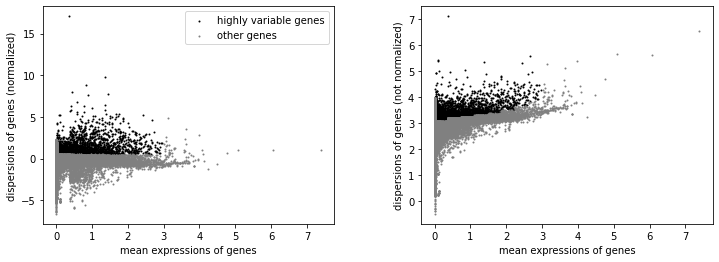

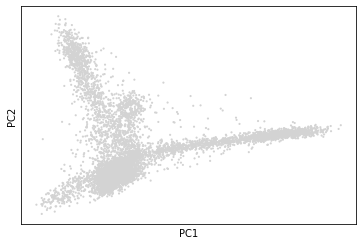

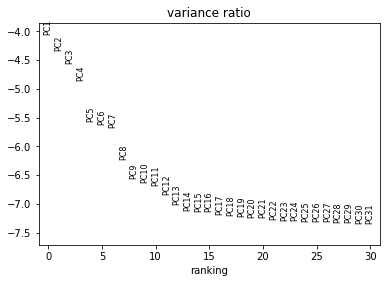

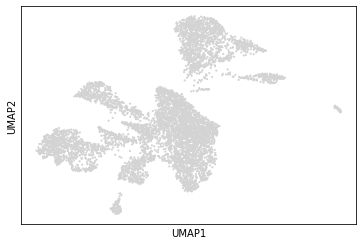

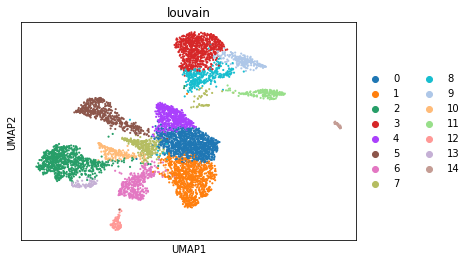

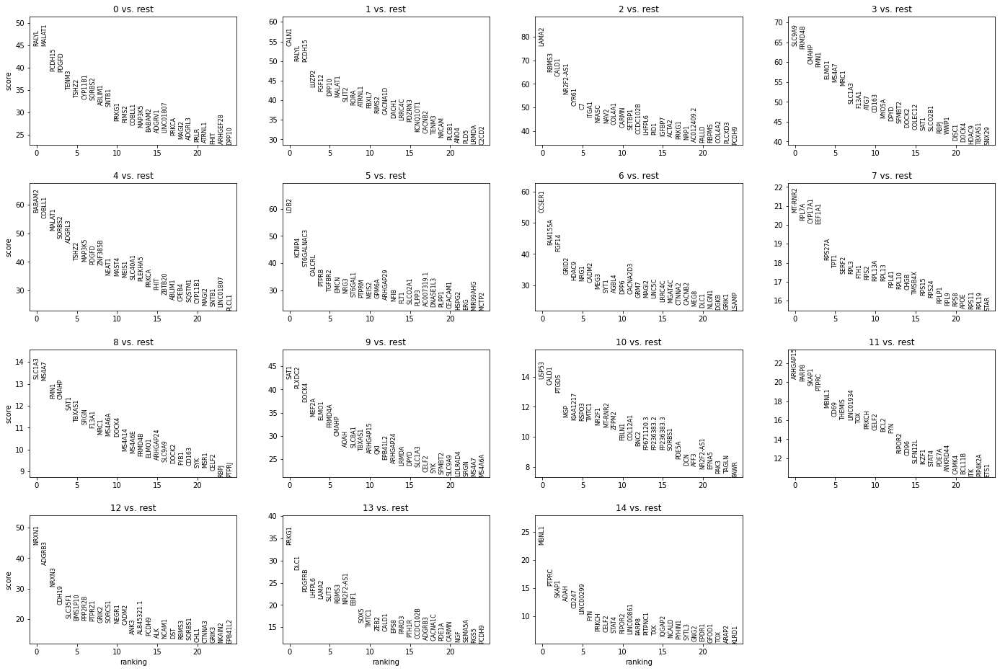

top gene names
        0       1          2       3       4           5        6        7  \
0   RALYL   CALN1      LAMA2  SLC9A9  BABAM2        LDB2   CCSER1  MT-RNR2   
1  MALAT1   RALYL      RBMS3  FRMD4B  COBLL1      KCNIP4  FAM155A    RPL7A   
2  PCDH15  PCDH15      CALD1   CMAHP  MALAT1  ST6GALNAC3    FGF14  CYP17A1   
3   PDGFD   LUZP2  NR2F2-AS1    FMN1  SORBS2      CALCRL    GRID2   EEF1A1   
4   TENM3   FGF12      CYR61   ELMO1  ADGRL3       PTPRB    HDAC9   RPS27A   

        8       9        10        11       12      13     14  
0  SLC1A3    SAT1     USP53  ARHGAP15    NRXN1   PRKG1  MBNL1  
1   MS4A7  PLXDC2     CALD1     PARP8   ADGRB3    DLC1  PTPRC  
2    FMN1   DOCK4     PTGDS     SKAP1    NRXN3  PDGFRB  SKAP1  
3   CMAHP   MEF2A       MGP     PTPRC    CDH19  LHFPL6   AOAH  
4    SAT1   ELMO1  KIAA1217     MBNL1  SLC35F1   LAMA2  CD247  
minimal 100% em clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


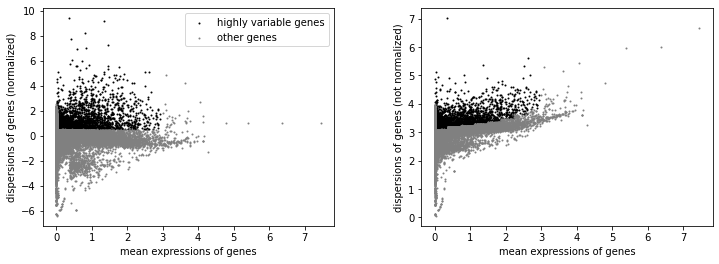

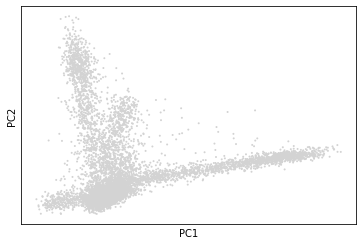

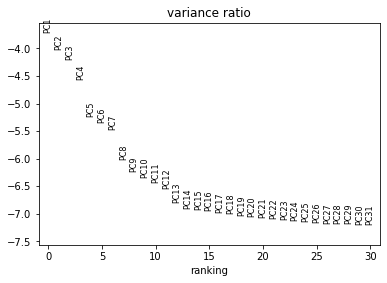

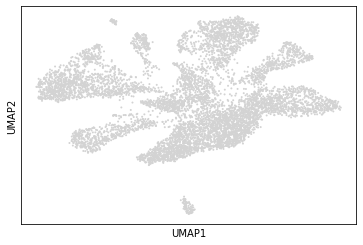

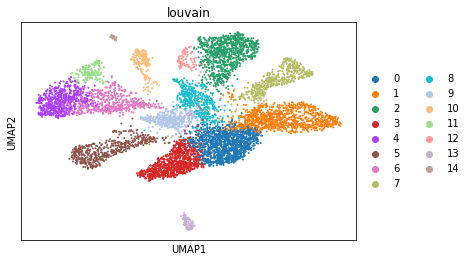

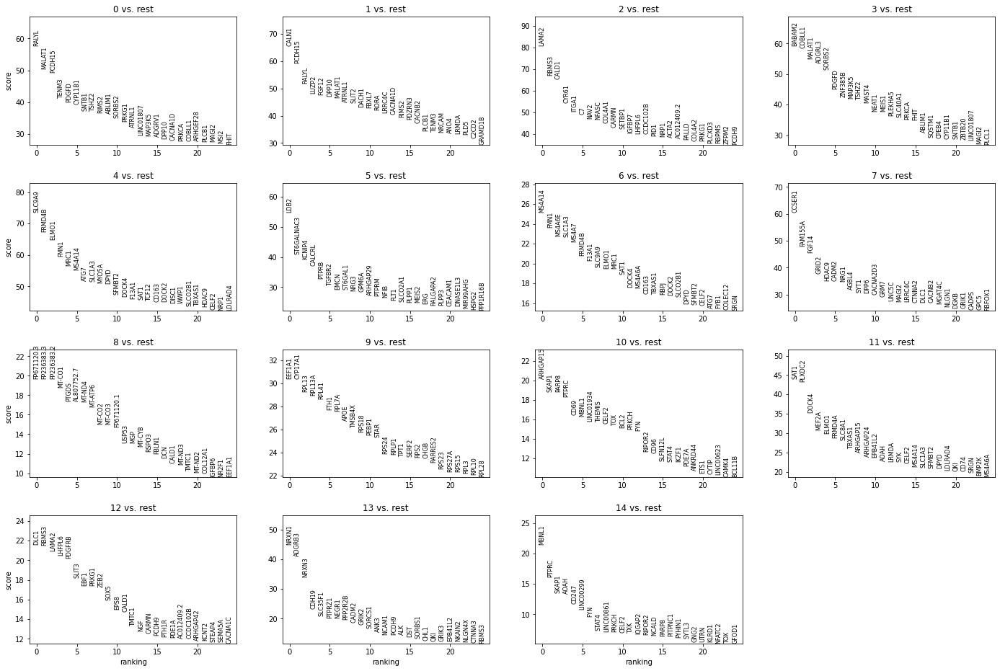

top gene names
        0       1      2       3       4           5       6        7  \
0   RALYL   CALN1  LAMA2  BABAM2  SLC9A9        LDB2  MS4A14   CCSER1   
1  MALAT1  PCDH15  RBMS3  COBLL1  FRMD4B  ST6GALNAC3    FMN1  FAM155A   
2  PCDH15   RALYL  CALD1  MALAT1   ELMO1      KCNIP4  MS4A6E    FGF14   
3   TENM3   LUZP2  CYR61  ADGRL3    FMN1      CALCRL  SLC1A3    GRID2   
4   PDGFD   FGF12  ITGA1  SORBS2    MRC1       PTPRB   MS4A7    HDAC9   

            8        9        10      11      12       13     14  
0  FP671120.3   EEF1A1  ARHGAP15    SAT1    DLC1    NRXN1  MBNL1  
1  FP236383.3  CYP17A1     SKAP1  PLXDC2   RBMS3   ADGRB3  PTPRC  
2  FP236383.2    RPL13     PARP8   DOCK4   LAMA2    NRXN3  SKAP1  
3      MT-CO1   RPL13A     PTPRC   MEF2A  LHFPL6    CDH19   AOAH  
4       PTGDS    RPL41      CD69   ELMO1  PDGFRB  SLC35F1  CD247  
minimal 50% em clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


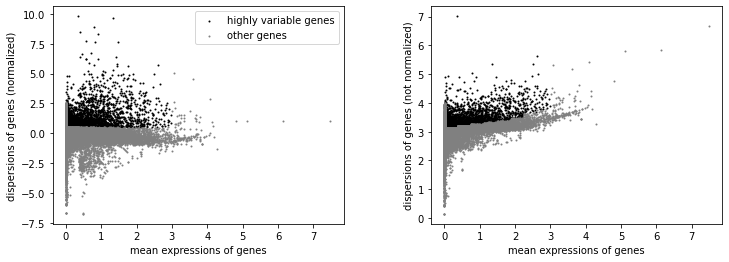

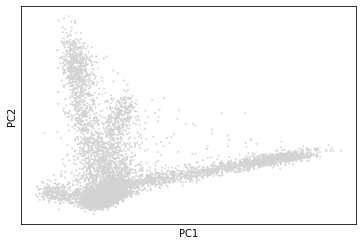

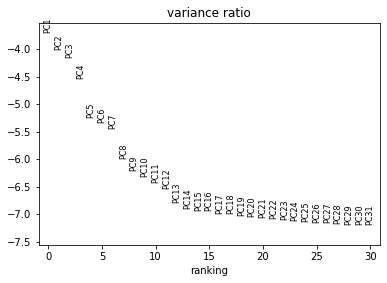

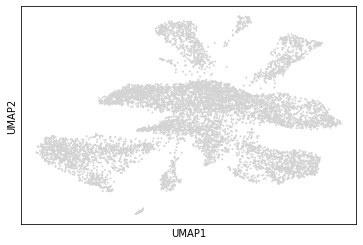

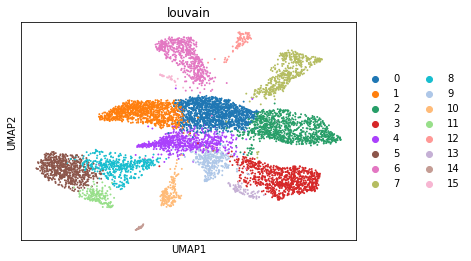

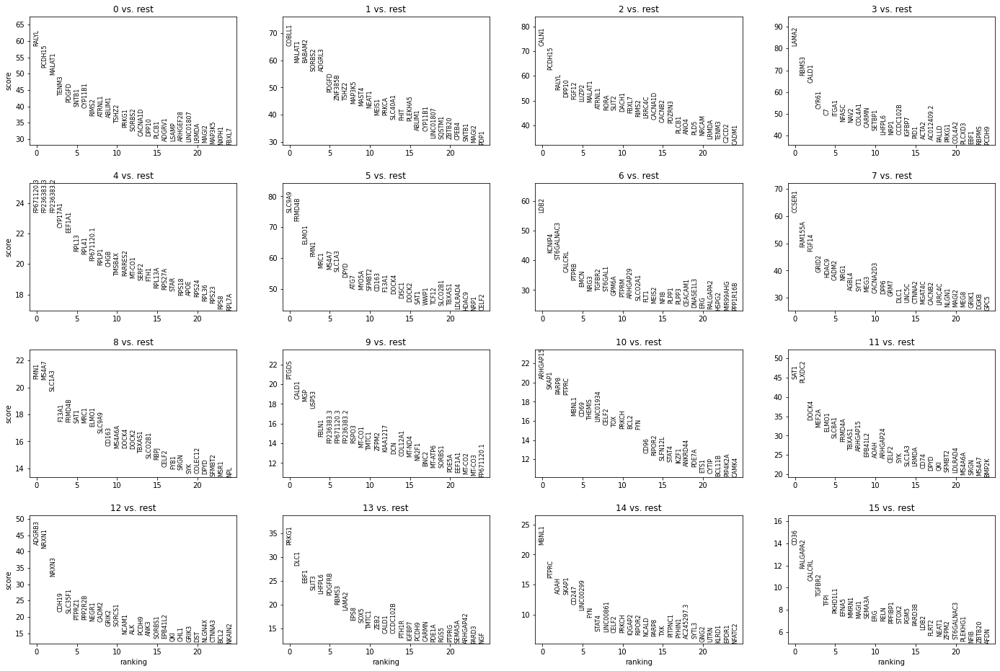

top gene names
        0       1       2      3           4       5           6        7  \
0   RALYL  COBLL1   CALN1  LAMA2  FP671120.3  SLC9A9        LDB2   CCSER1   
1  PCDH15  MALAT1  PCDH15  RBMS3  FP236383.3  FRMD4B      KCNIP4  FAM155A   
2  MALAT1  BABAM2   RALYL  CALD1  FP236383.2   ELMO1  ST6GALNAC3    FGF14   
3   TENM3  SORBS2   DPP10  CYR61     CYP17A1    FMN1      CALCRL    GRID2   
4   PDGFD  ADGRL3   FGF12     C7      EEF1A1    MRC1       PTPRB    HDAC9   

        8      9        10      11       12      13     14        15  
0    FMN1  PTGDS  ARHGAP15    SAT1   ADGRB3   PRKG1  MBNL1      CD36  
1   MS4A7  CALD1     SKAP1  PLXDC2    NRXN1    DLC1  PTPRC  RALGAPA2  
2  SLC1A3    MGP     PARP8   DOCK4    NRXN3    EBF1   AOAH    CALCRL  
3   F13A1  USP53     PTPRC   MEF2A    CDH19   SLIT3  SKAP1    TGFBR2  
4  FRMD4B  FBLN1     MBNL1   ELMO1  SLC35F1  LHFPL6  CD247      TFPI  
tenx 100% em clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


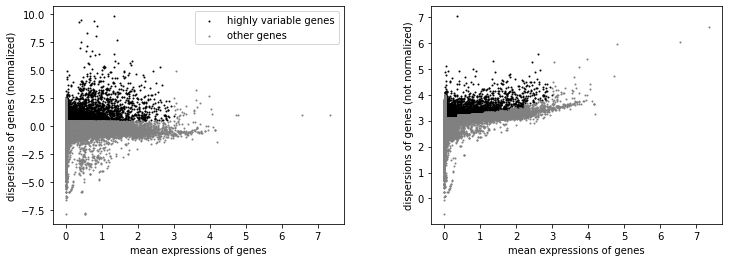

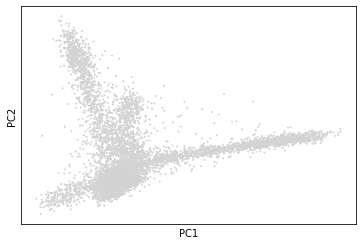

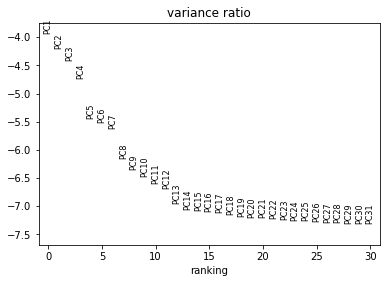

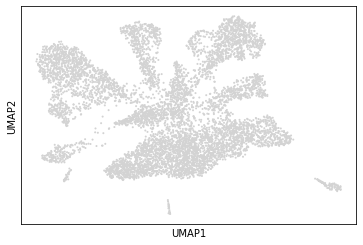

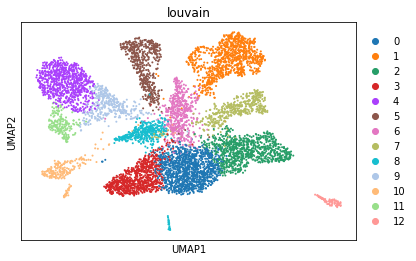

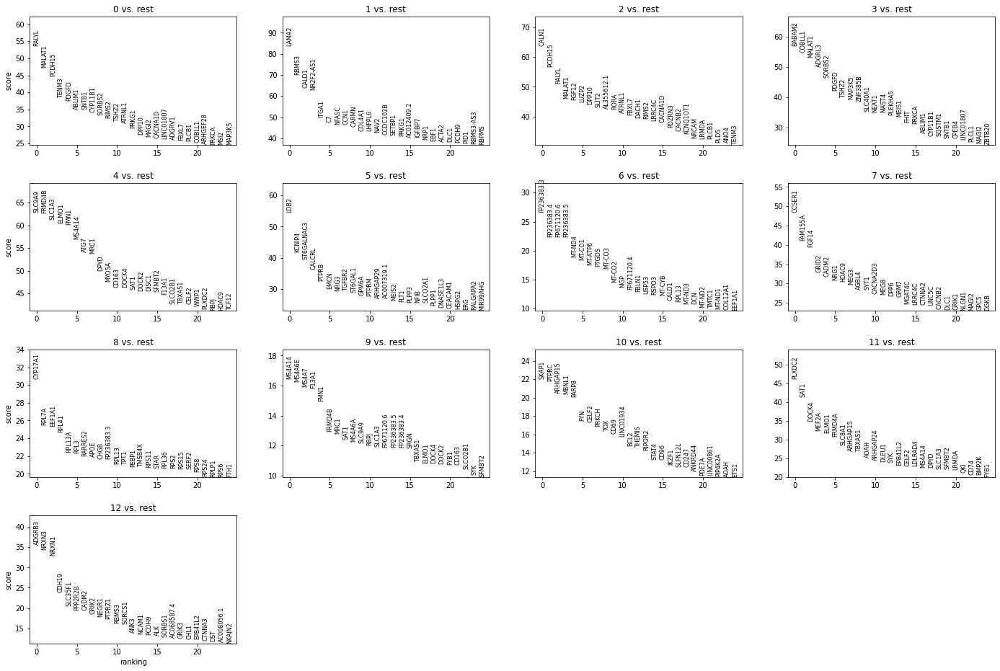

top gene names
        0          1       2       3       4           5           6        7  \
0   RALYL      LAMA2   CALN1  BABAM2  SLC9A9        LDB2  FP236383.1   CCSER1   
1  MALAT1      RBMS3  PCDH15  COBLL1  FRMD4B      KCNIP4  FP236383.2  FAM155A   
2  PCDH15      CALD1   RALYL  MALAT1  SLC1A3  ST6GALNAC3  FP671120.3    FGF14   
3   TENM3  NR2F2-AS1  MALAT1  ADGRL3   ELMO1      CALCRL  FP236383.3    GRID2   
4   PDGFD      ITGA1   FGF12  SORBS2    FMN1       PTPRB      MT-ND4    CADM2   

         8       9        10      11       12  
0  CYP17A1  MS4A14     SKAP1  PLXDC2   ADGRB3  
1    RPL7A  MS4A6E     PTPRC    SAT1    NRXN3  
2   EEF1A1   MS4A7  ARHGAP15   DOCK4    NRXN1  
3    RPL41   F13A1     MBNL1   MEF2A    CDH19  
4   RPL13A    FMN1     PARP8   ELMO1  SLC35F1  
tenx 50% em clustering


/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


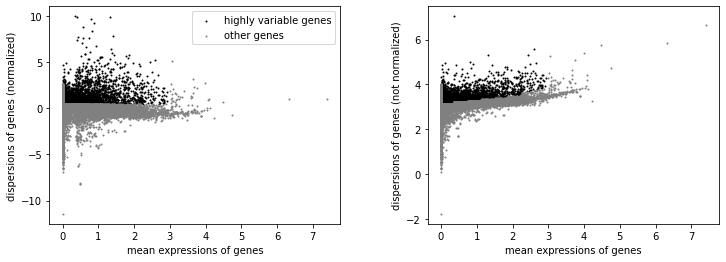

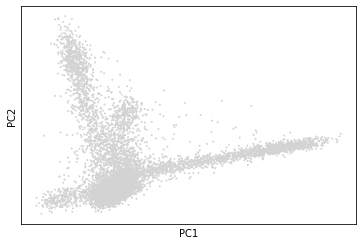

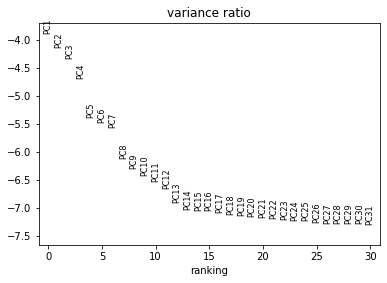

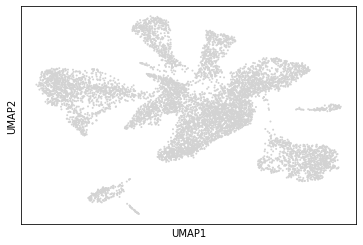

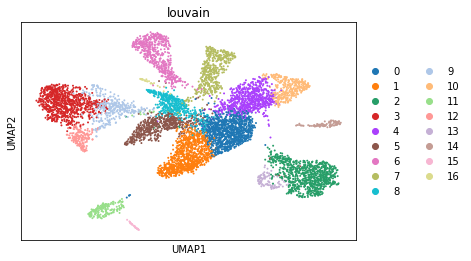

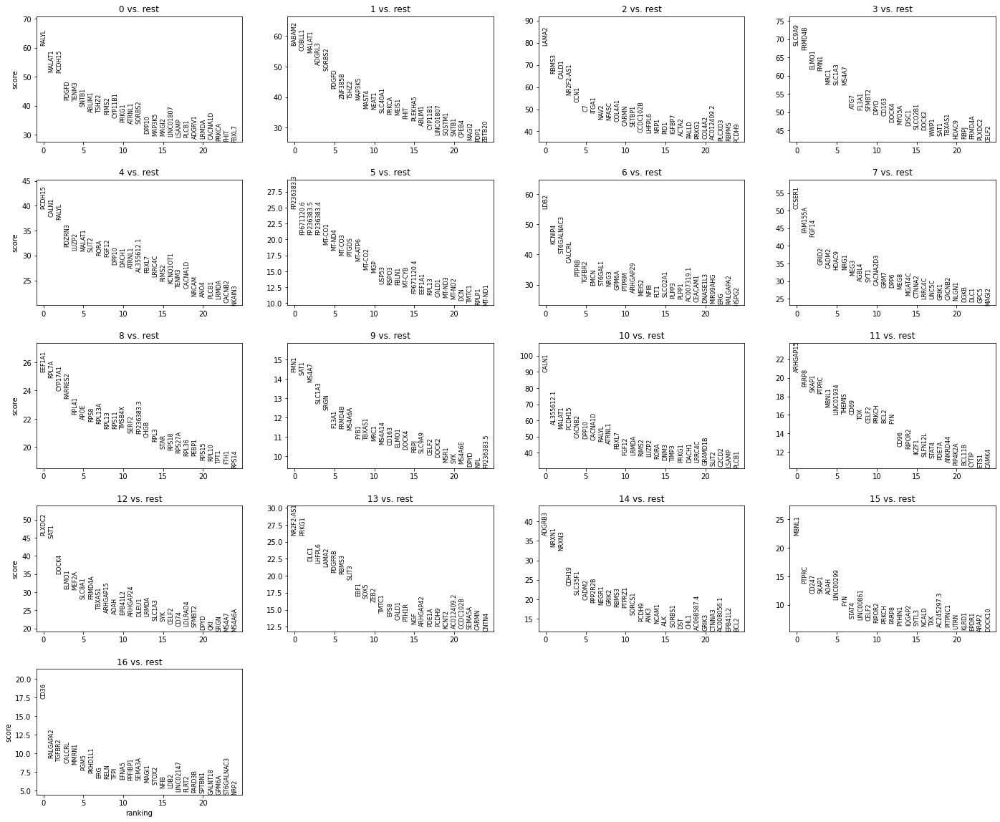

top gene names
        0       1          2       3       4           5           6        7  \
0   RALYL  BABAM2      LAMA2  SLC9A9  PCDH15  FP236383.1        LDB2   CCSER1   
1  MALAT1  COBLL1      RBMS3  FRMD4B   CALN1  FP671120.3      KCNIP4  FAM155A   
2  PCDH15  MALAT1      CALD1   ELMO1   RALYL  FP236383.3  ST6GALNAC3    FGF14   
3   PDGFD  ADGRL3  NR2F2-AS1    FMN1  PDZRN3  FP236383.2      CALCRL    GRID2   
4   TENM3  SORBS2      CYR61    MRC1   LUZP2      MT-CO1       PTPRB    CADM2   

         8       9          10        11      12         13       14     15  \
0   EEF1A1    FMN1       CALN1  ARHGAP15  PLXDC2  NR2F2-AS1   ADGRB3  MBNL1   
1    RPL7A    SAT1  AL590426.2     PARP8    SAT1      PRKG1    NRXN1  PTPRC   
2  CYP17A1   MS4A7      MALAT1     SKAP1   DOCK4       DLC1    NRXN3  CD247   
3  RARRES2  SLC1A3      PCDH15     PTPRC   ELMO1     LHFPL6    CDH19  SKAP1   
4    RPL41    SRGN      CACNB2     MBNL1   MEF2A      LAMA2  SLC35F1   AOAH   

         16  
0      CD

In [18]:
algorithm_scanpy_filtered = {}
algorithm_top_gene_ids = {}
algorithm_top_gene_names = {}
for algorithm in algorithm_filtered:
    #print(display.HTML('<h1>{algorithm} first phase QC</h1><a class="anchor-link" href="#{algorithm}-first-phase-QC">¶</a>'.format(algorithm=algorithm)))
    print("{algorithm} clustering".format(algorithm=algorithm))
    algorithm_scanpy_filtered[algorithm] = algorithm_filtered[algorithm][algorithm_filtered[algorithm].obs.n_genes_by_counts < 2000, :]
    algorithm_scanpy_filtered[algorithm] = algorithm_scanpy_filtered[algorithm][algorithm_scanpy_filtered[algorithm].obs.pct_counts_mt < 2.5, :]
    
    scanpy.pp.normalize_total(algorithm_scanpy_filtered[algorithm], target_sum=30000)
    scanpy.pp.log1p(algorithm_scanpy_filtered[algorithm])
    scanpy.pp.highly_variable_genes(algorithm_scanpy_filtered[algorithm], min_mean=0.0125, max_mean=3, min_disp=0.5)
    scanpy.pl.highly_variable_genes(algorithm_scanpy_filtered[algorithm])
    algorithm_scanpy_filtered[algorithm].raw = algorithm_scanpy_filtered[algorithm]
    algorithm_scanpy_filtered[algorithm] = algorithm_scanpy_filtered[algorithm][:, algorithm_scanpy_filtered[algorithm].var.highly_variable]
   
    scanpy.pp.regress_out( algorithm_scanpy_filtered[algorithm], ['total_counts', 'pct_counts_mt'])
    scanpy.pp.scale( algorithm_scanpy_filtered[algorithm], max_value=10)
    scanpy.tl.pca(algorithm_scanpy_filtered[algorithm], svd_solver='arpack')
    scanpy.pl.pca(algorithm_scanpy_filtered[algorithm])

    scanpy.pl.pca_variance_ratio(algorithm_scanpy_filtered[algorithm], log=True)
    
    scanpy.pp.neighbors(algorithm_scanpy_filtered[algorithm], n_neighbors=10, n_pcs=40)
    scanpy.tl.umap(algorithm_scanpy_filtered[algorithm])
    scanpy.pl.umap(algorithm_scanpy_filtered[algorithm])
    
    scanpy.tl.louvain(algorithm_scanpy_filtered[algorithm])
    scanpy.pl.umap(algorithm_scanpy_filtered[algorithm], color=['louvain'])
    
    scanpy.tl.rank_genes_groups(algorithm_scanpy_filtered[algorithm], 'louvain', method='t-test')
    scanpy.pl.rank_genes_groups(algorithm_scanpy_filtered[algorithm], n_genes=25, sharey=False, gene_symbols='gene_name')
    
    algorithm_top_gene_ids[algorithm] = pandas.DataFrame(algorithm_scanpy_filtered[algorithm].uns['rank_genes_groups']['names'])    
    if algorithm == "tenx solo uniq":
        algorithm_top_gene_names[algorithm] = algorithm_top_gene_ids[algorithm].applymap(lambda x: v32m_gene_id_to_name.get(x, x))
    else:
        algorithm_top_gene_names[algorithm] = algorithm_top_gene_ids[algorithm].applymap(lambda x: v29_gene_id_to_name.get(x, x))
    print('top gene names')
    print(algorithm_top_gene_names[algorithm].head(5))

# Gene IDs in common after scanpy filtering

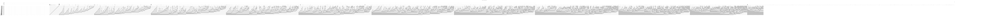

In [19]:
common_filtered_gene_base_contents = {}
for algorithm in algorithm_scanpy_filtered:
    #if algorithm == 'tenx solo uniq':
    #    common_filtered_gene_base_contents[algorithm] = {gene_id for gene_id in algorithm_scanpy_filtered[algorithm].var_names}
    #else:
    #common_filtered_gene_base_contents[algorithm] = {gene_id.split('.')[0] for gene_id in algorithm_scanpy_filtered[algorithm].var_names}
    common_filtered_gene_base_contents[algorithm] = set(algorithm_scanpy_filtered[algorithm].var_names)

# tenx is using gencode.v32.primary_assembly.annotation.gtf.filtered
common_filtered_gene_base_set = upsetplot.from_contents(common_filtered_gene_base_contents)

f = pyplot.figure()
f.suptitle("Gene ids in common after scanpy")
_ = upsetplot.plot(common_filtered_gene_base_set, show_counts=True, fig=f)

In [20]:
def build_confusion_matrix(left, right, N=20):
    confusion = {}
    for cluster in left:
        for gene in left[cluster].head(N):
            confusion.setdefault(gene, {})['left'] = int(cluster)

    for cluster in right:
        for gene in right[cluster].head(N):
            confusion.setdefault(gene, {})['right'] = int(cluster)

    last_left = int(left.columns[-1]) + 1
    last_right = int(right.columns[-1]) + 1

    confusion_matrix = numpy.zeros((last_left+1, last_right+1))

    for gene in confusion:
        x = confusion[gene].get('left', last_left)
        y = confusion[gene].get('right', last_right)
        confusion_matrix[x,y] += 1
    return confusion_matrix

# Confusion matrices between top N genes in each cluster

In [21]:
def plot_algorithm_confusion(table, programs=None, N=20):
    if programs is None:
        programs = list(table.keys())
    confusion = {}
    plot_size = len(programs)-1
    figsize = (3 * plot_size, 3 * plot_size)
    f = pyplot.figure(figsize=figsize)

    axes = f.subplots(plot_size, plot_size, sharex=True, sharey=True)
    if plot_size == 1:
        axes = numpy.array([[axes]])
    for x, name_x in enumerate(programs):
        for y, name_y in enumerate(programs[programs.index(name_x)+1:]):
            #plot_index = plot_size * (y+x) + x + 1
            #ax = f.add_subplot(plot_size, plot_size, plot_index)
            ax = axes[y+x, x]
            cm = build_confusion_matrix(table[name_x], table[name_y], N)
            seaborn.heatmap(cm, annot=False, ax=ax)
            
            if x == 0:
                ax.set_ylabel(name_y)
    for y in range(plot_size):
        axes[0, y].set_title(programs[y])
        axes[plot_size-1, y].set_xlabel(programs[y])
    f.suptitle("Gene name confusion matrix of top {} genes".format(N))
    #f.tight_layout()


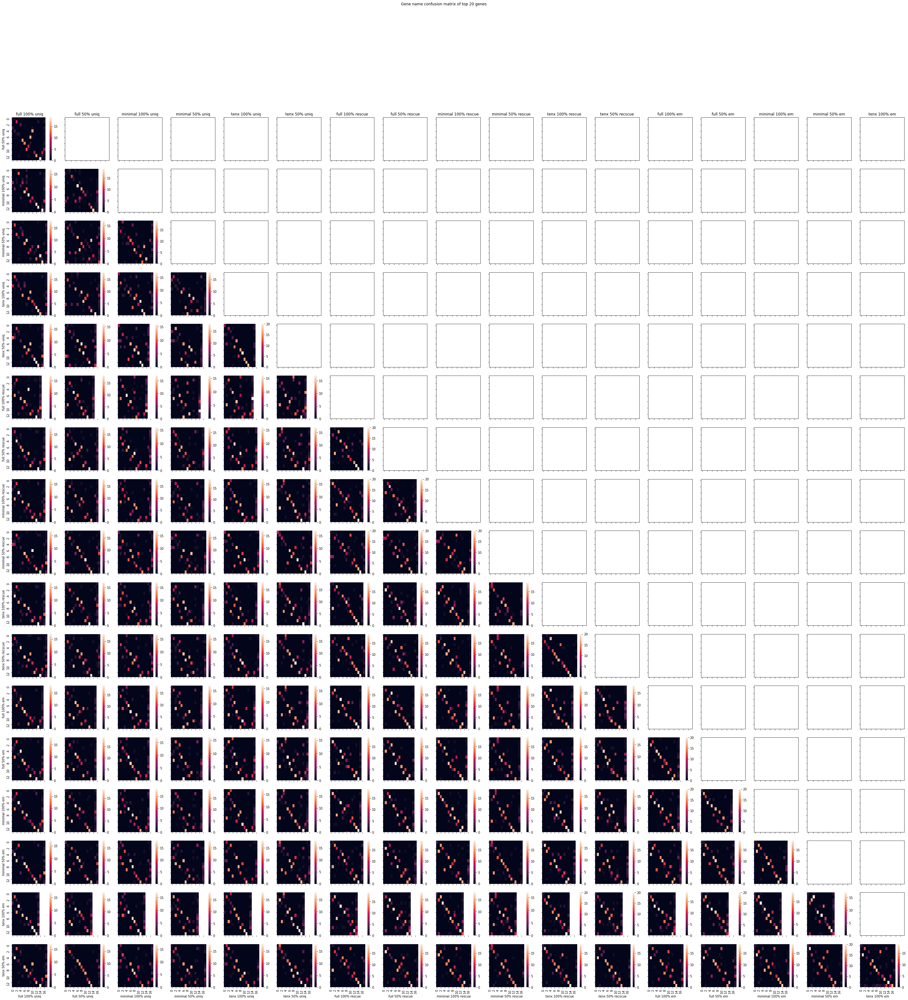

In [22]:
plot_algorithm_confusion(algorithm_top_gene_names, N=20)

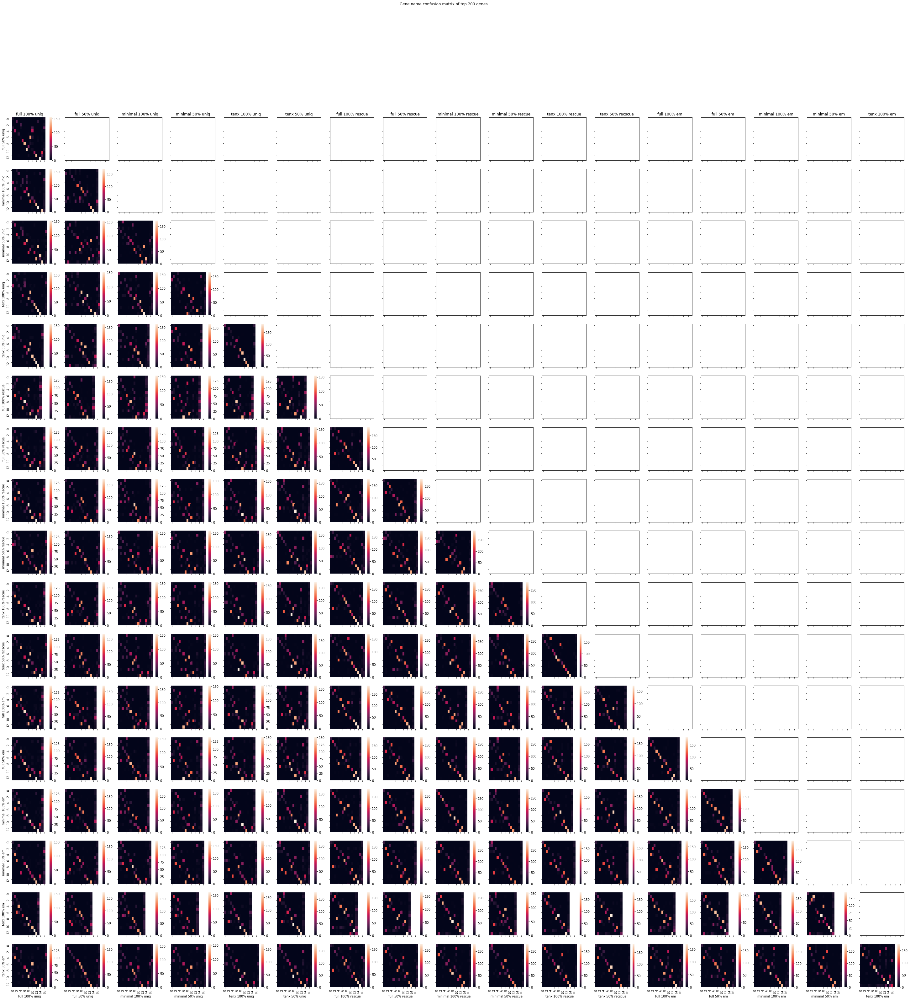

In [23]:
plot_algorithm_confusion(algorithm_top_gene_names, N=200)

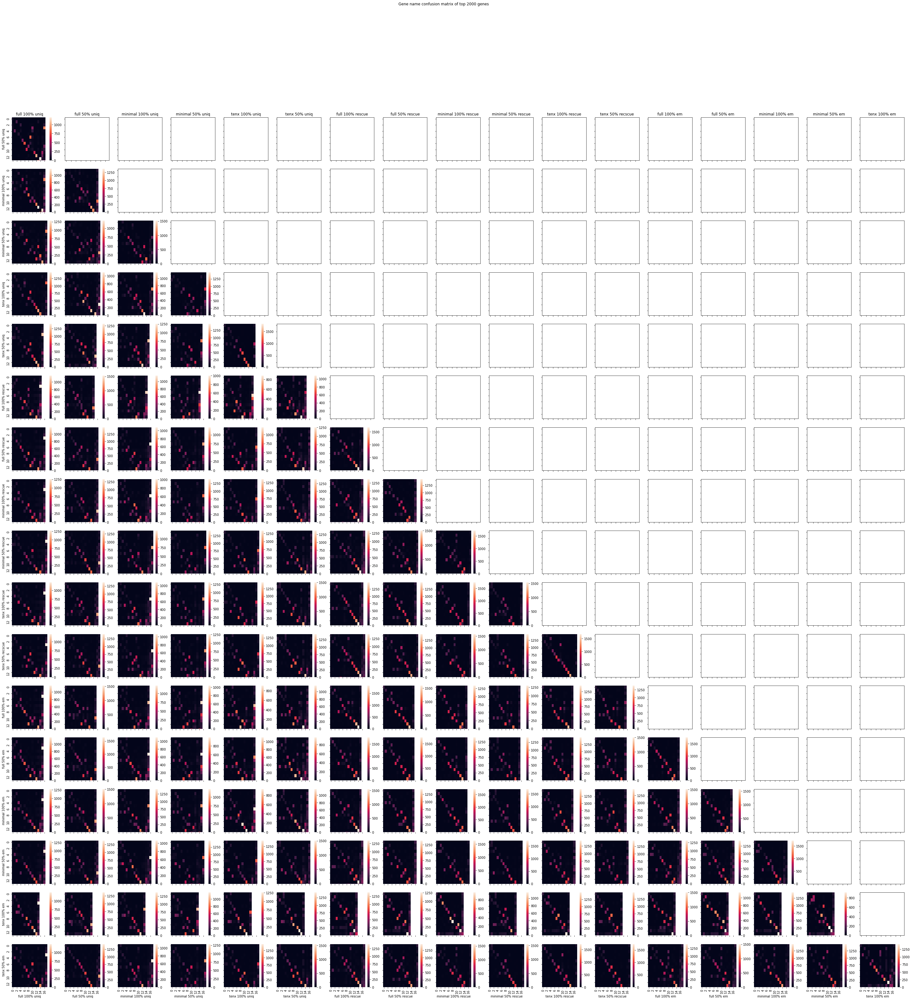

In [24]:
plot_algorithm_confusion(algorithm_top_gene_names, N=2000)

In [25]:
algorithm_filtered

{'full 100% uniq': AnnData object with n_obs × n_vars = 15605 × 32644
     obs: 'counts', 'ngenes', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
     var: 'gene_name', 'gene_type', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
 'full 50% uniq': AnnData object with n_obs × n_vars = 15708 × 35285
     obs: 'counts', 'ngenes', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
     var: 'gene_name', 'gene_type', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
 'minimal 100% uniq': AnnData object with n_obs × n_vars = 15650 × 22540
     obs: 'counts', 'ngenes', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
     var: 'gene_name', 'gene_type', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
 'minimal 50% uniq': AnnData object with n_obs × n_vars = 1

# Lets smoosh the datasets together

In [27]:
combined = anndata.concat(
    [algorithm_filtered[x] for x in algorithm_filtered],
    merge='same',
)
combined

AnnData object with n_obs × n_vars = 283248 × 21491
    obs: 'counts', 'ngenes', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt'

In [31]:
combined.var['gene_name'] = [v29_gene_id_to_name.get(x, x) for x in combined.var_names]
combined.var['gene_type'] = [v29_gene_id_to_type.get(x, x) for x in combined.var_names]
combined.obs['method'] = [x.split('_')[1] for x in combined.obs_names]

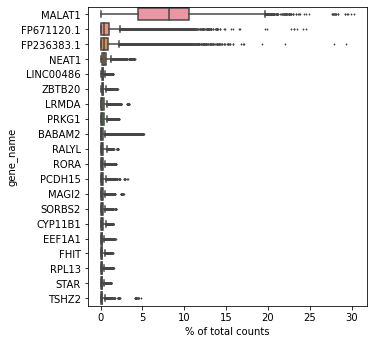

... storing 'donor' as categorical
... storing 'method' as categorical
... storing 'gene_name' as categorical
... storing 'gene_type' as categorical
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/usr/lib/python3/dist-packages/seaborn/_core.py:1319: UserWarning: Vertical orientation ignored with only `x` specified.
  warn

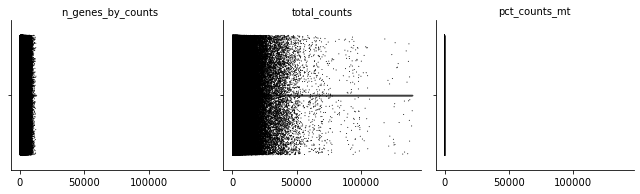

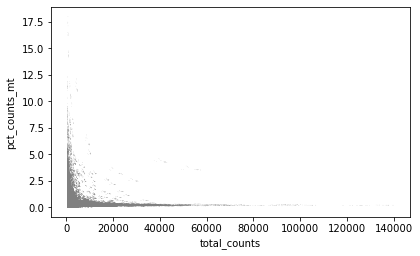

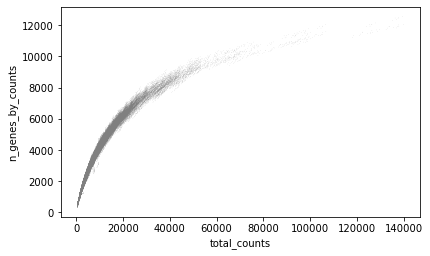

In [32]:
scanpy.pl.highest_expr_genes(combined, n_top=20, gene_symbols='gene_name')
scanpy.pp.filter_cells(combined, min_genes=200)
scanpy.pp.filter_genes(combined, min_cells=3)
algorithm_filtered[algorithm].var['mt'] = combined.var['gene_name'].str.startswith("MT-")
scanpy.pp.calculate_qc_metrics(combined, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
scanpy.pl.violin(
    combined,
    ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
    jitter=0.4, multi_panel=True)
scanpy.pl.scatter(combined, x='total_counts', y='pct_counts_mt')
scanpy.pl.scatter(combined, x='total_counts', y='n_genes_by_counts')        

/usr/lib/python3/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


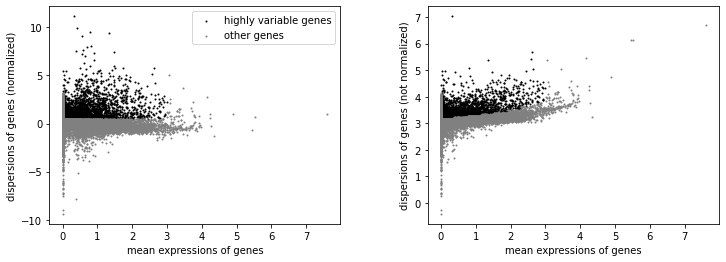

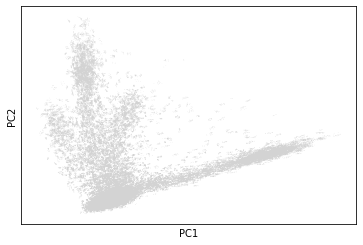

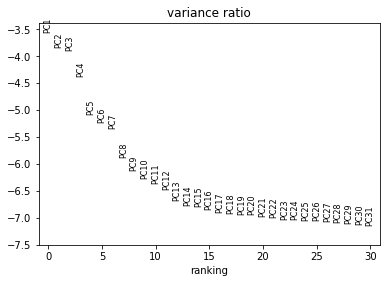

/usr/lib/python3/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


In [ ]:
#print(display.HTML('<h1>{algorithm} first phase QC</h1><a class="anchor-link" href="#{algorithm}-first-phase-QC">¶</a>'.format(algorithm=algorithm)))
combined_scanpy = combined[combined.obs.n_genes_by_counts < 2000, :]
combined_scanpy = combined_scanpy[combined_scanpy.obs.pct_counts_mt < 2.5, :]

scanpy.pp.normalize_total(combined_scanpy, target_sum=30000)
scanpy.pp.log1p(combined_scanpy)
scanpy.pp.highly_variable_genes(combined_scanpy, min_mean=0.0125, max_mean=3, min_disp=0.5)
scanpy.pl.highly_variable_genes(combined_scanpy)
combined_scanpy.raw = combined_scanpy
combined_scanpy = combined_scanpy[:, combined_scanpy.var.highly_variable]

scanpy.pp.regress_out(combined_scanpy, ['total_counts', 'pct_counts_mt'])
scanpy.pp.scale(combined_scanpy, max_value=10)
scanpy.tl.pca(combined_scanpy, svd_solver='arpack')
scanpy.pl.pca(combined_scanpy)

scanpy.pl.pca_variance_ratio(combined_scanpy, log=True)

scanpy.pp.neighbors(combined_scanpy, n_neighbors=10, n_pcs=40)
scanpy.tl.umap(combined_scanpy)
scanpy.pl.umap(combined_scanpy)

scanpy.tl.louvain(combined_scanpy)
scanpy.pl.umap(combined_scanpy, color=['louvain'])

scanpy.tl.leiden(combined_scanpy)
scanpy.pl.umap(combined_scanpy, color=['leiden'])

scanpy.tl.rank_genes_groups(combined_scanpy, 'leiden', method='t-test')
scanpy.pl.rank_genes_groups(combined_scanpy, n_genes=25, sharey=False, gene_symbols='gene_name')

combined_top_gene_ids = pandas.DataFrame(combined_scanpy.uns['rank_genes_groups']['names'])    
print('top gene names')
combined_top_gene_names = combined_top_gene_ids.applymap(lambda x: v29_gene_id_to_name.get(x, x))
print('top gene names')
combined_top_gene_names

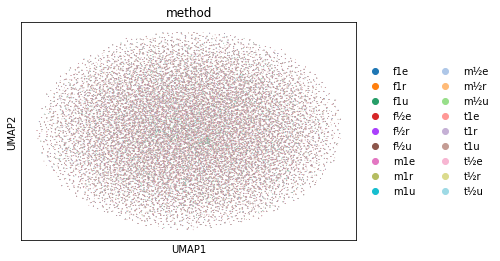

In [34]:
scanpy.pl.umap(combined_scanpy, color=['method'])

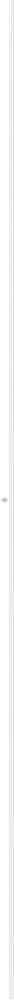

In [35]:
scanpy.pl.umap(combined_scanpy, color=['louvain'])

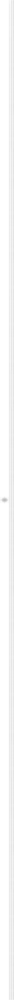

In [36]:
scanpy.pl.umap(combined_scanpy, color=['leiden'])